# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [10]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [11]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [12]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [13]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [14]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [15]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [16]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.282415896773338, discriminator loss: 0.23793940841034056


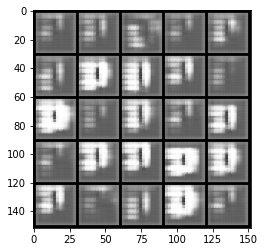

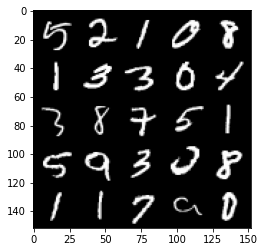

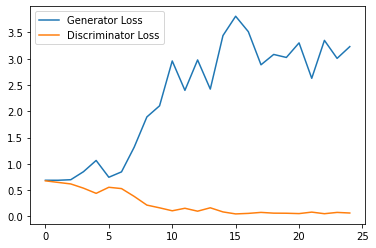

Step 1000: Generator loss: 4.337923717975617, discriminator loss: 0.0433831232637167


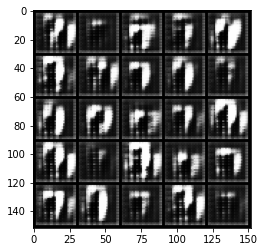

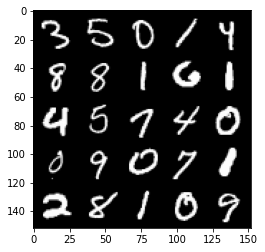

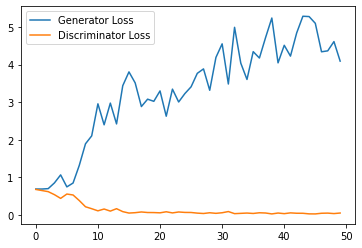

Step 1500: Generator loss: 3.985065670013428, discriminator loss: 0.06726473164185881


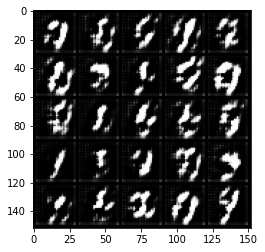

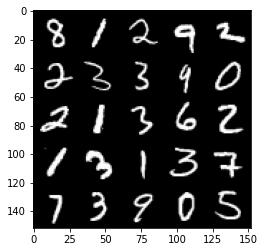

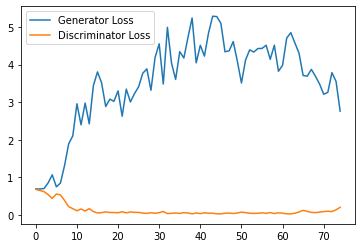

Step 2000: Generator loss: 2.7837493290901185, discriminator loss: 0.22808166579902173


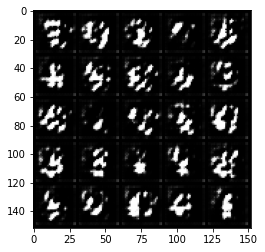

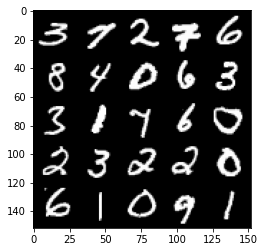

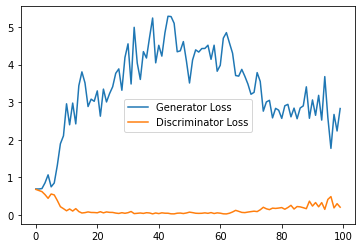

Step 2500: Generator loss: 2.193691596508026, discriminator loss: 0.30129465714097026


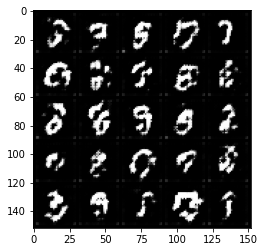

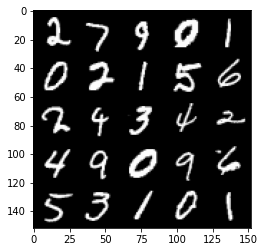

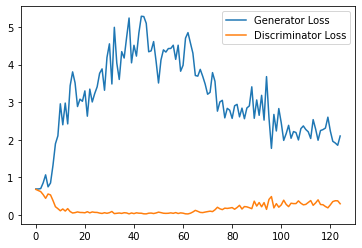

Step 3000: Generator loss: 2.296617288827896, discriminator loss: 0.30345165529847146


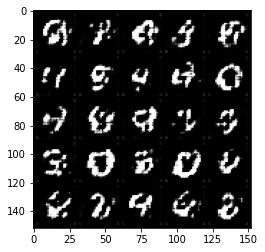

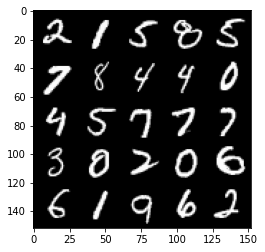

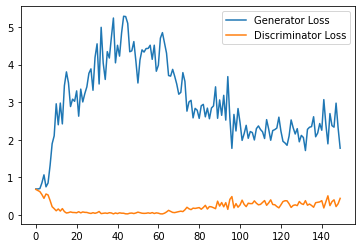

Step 3500: Generator loss: 2.138596625328064, discriminator loss: 0.31677438032627103


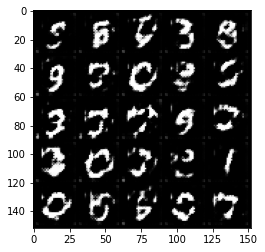

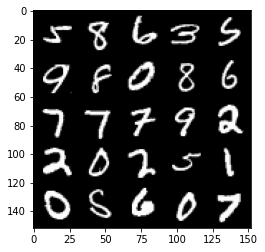

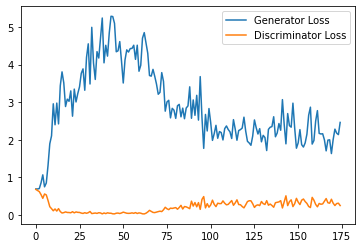

Step 4000: Generator loss: 1.9922548580169677, discriminator loss: 0.33424551466107366


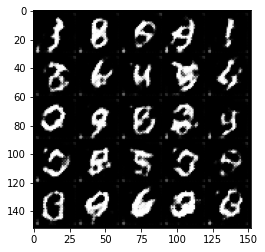

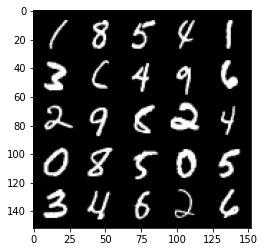

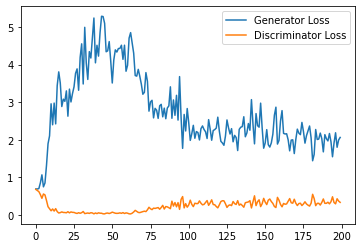

Step 4500: Generator loss: 1.9282761189937592, discriminator loss: 0.3593951490521431


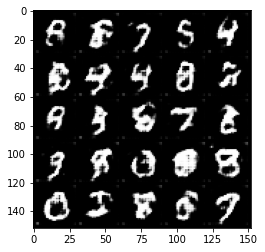

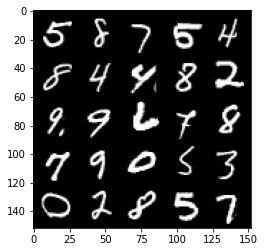

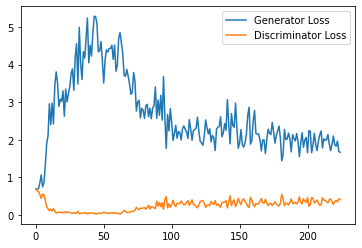

Step 5000: Generator loss: 1.8599079358577728, discriminator loss: 0.3578841242790222


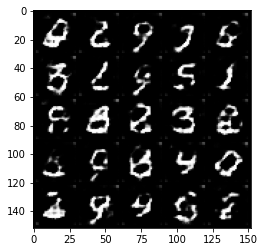

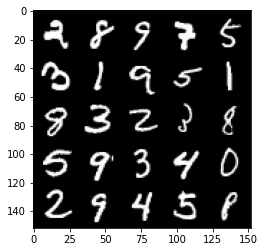

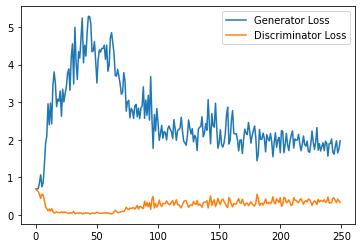

Step 5500: Generator loss: 1.679794265627861, discriminator loss: 0.4090862853527069


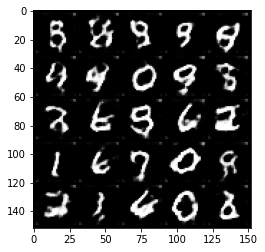

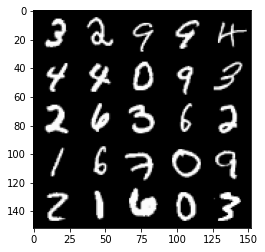

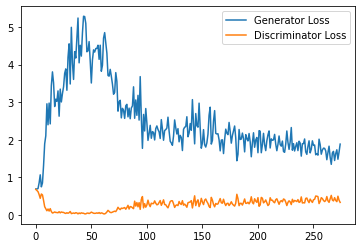

Step 6000: Generator loss: 1.5914927493333817, discriminator loss: 0.43621407812833785


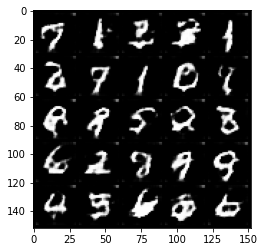

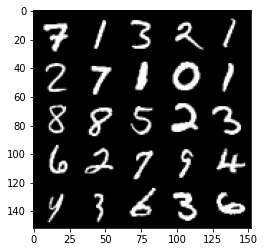

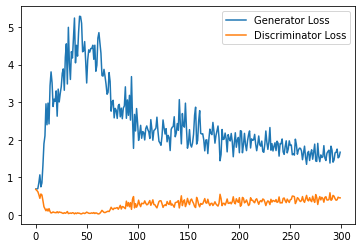

Step 6500: Generator loss: 1.6420399177074432, discriminator loss: 0.4443451862037182


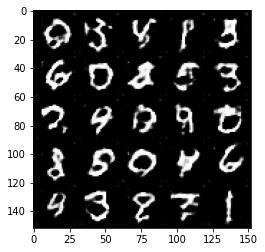

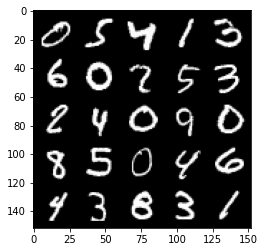

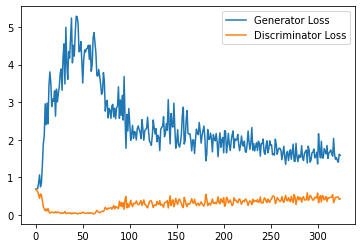

Step 7000: Generator loss: 1.4293602187633514, discriminator loss: 0.48009957778453827


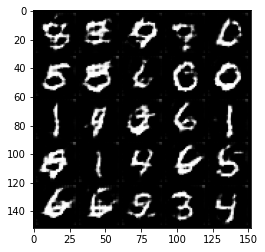

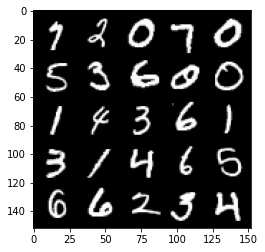

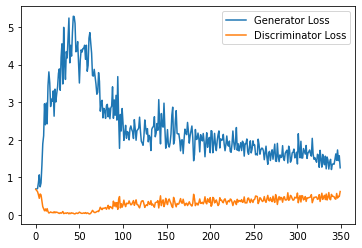

Step 7500: Generator loss: 1.4059427433013916, discriminator loss: 0.47615522664785387


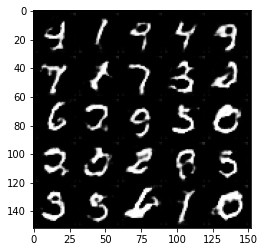

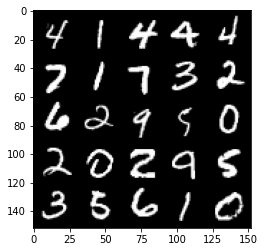

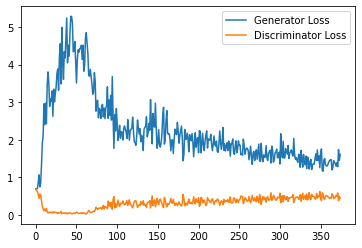

Step 8000: Generator loss: 1.4250730957984925, discriminator loss: 0.5052880004048348


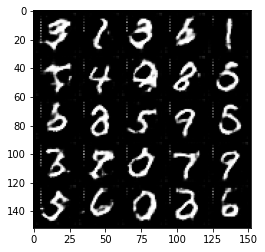

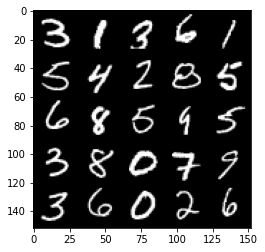

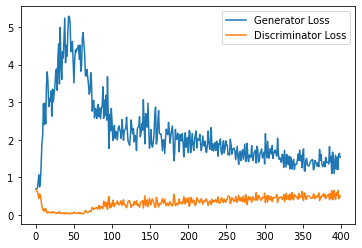

Step 8500: Generator loss: 1.2697422111034393, discriminator loss: 0.5203214917778969


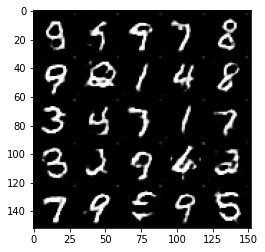

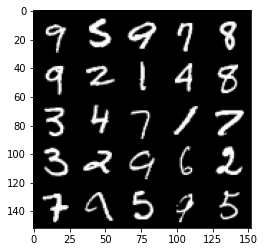

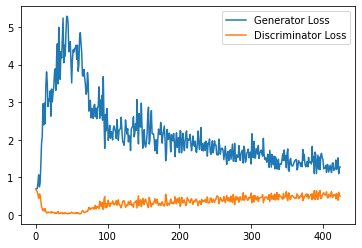

Step 9000: Generator loss: 1.3274015132188797, discriminator loss: 0.5250086547136307


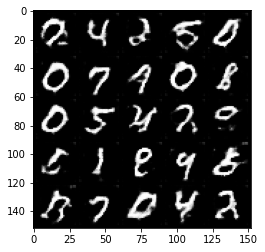

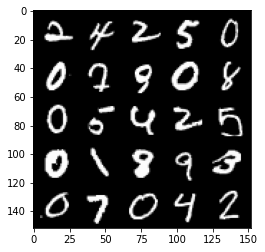

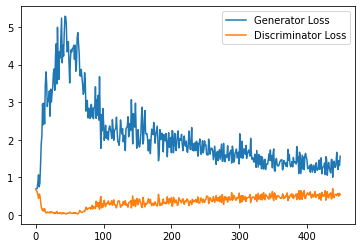

Step 9500: Generator loss: 1.3581022509336471, discriminator loss: 0.5298948836922646


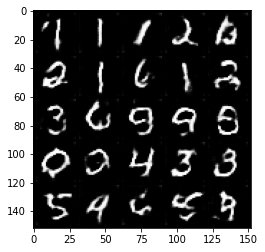

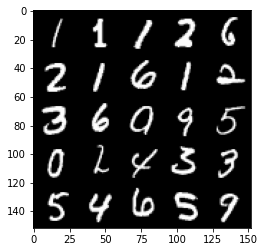

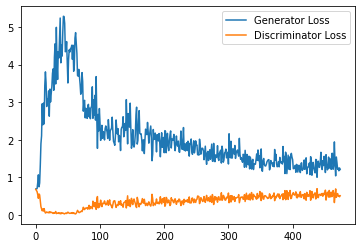

Step 10000: Generator loss: 1.2146258524656295, discriminator loss: 0.5279270614981652


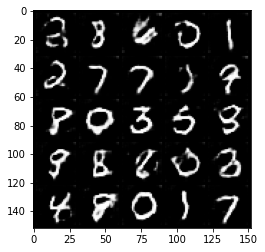

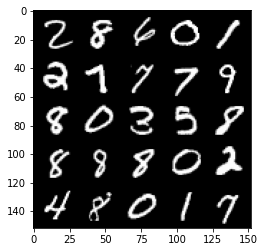

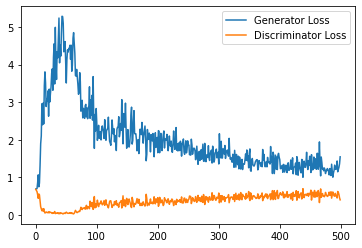

Step 10500: Generator loss: 1.2278038096427917, discriminator loss: 0.5409229471087456


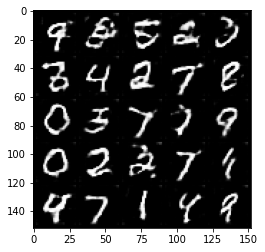

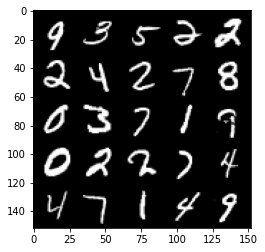

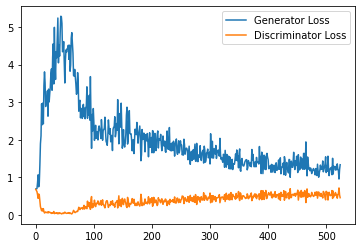

Step 11000: Generator loss: 1.1587404407262802, discriminator loss: 0.5498598357439041


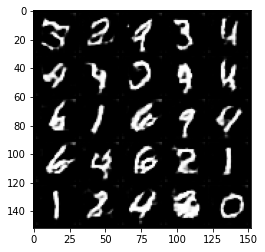

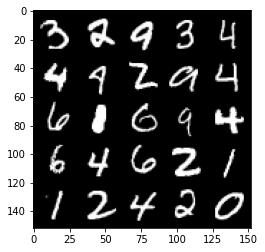

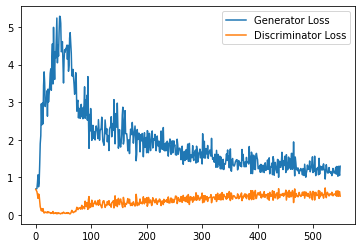

Step 11500: Generator loss: 1.1358083093166351, discriminator loss: 0.5618197969198226


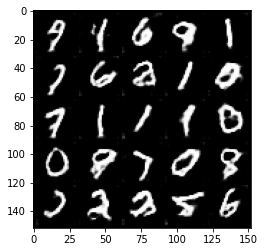

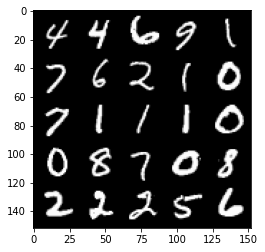

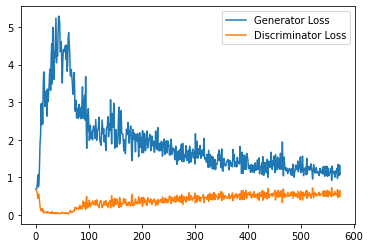

Step 12000: Generator loss: 1.1670526953935623, discriminator loss: 0.5721262190937996


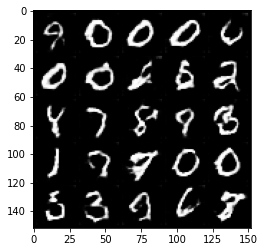

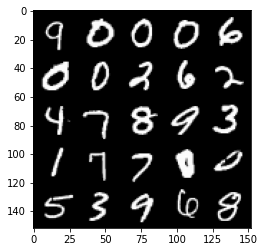

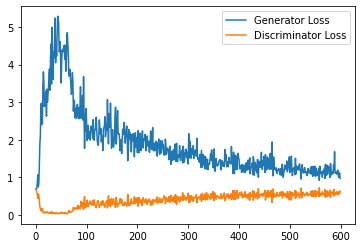

Step 12500: Generator loss: 1.1543626872301103, discriminator loss: 0.5588277832269669


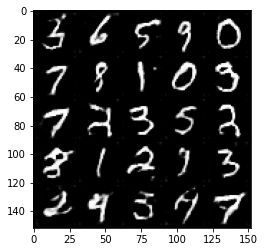

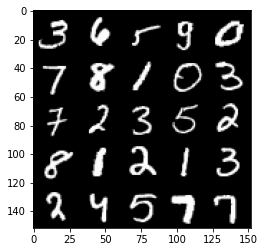

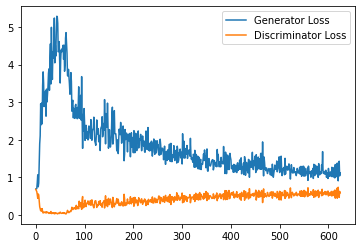

Step 13000: Generator loss: 1.1349876899719238, discriminator loss: 0.5754859024882316


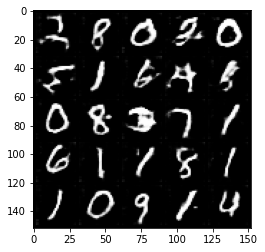

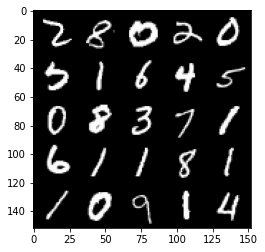

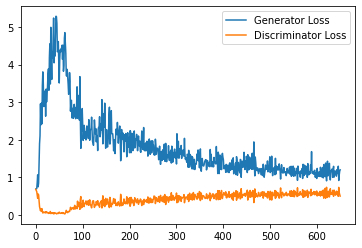

Step 13500: Generator loss: 1.0683200266361237, discriminator loss: 0.5720322511196136


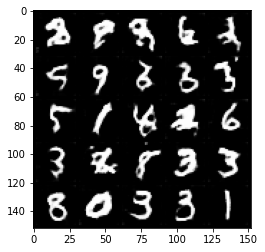

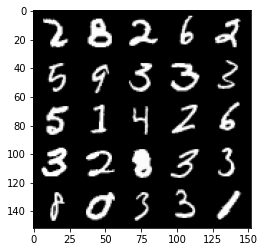

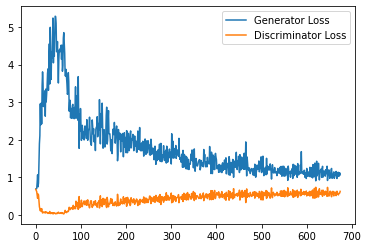

Step 14000: Generator loss: 1.1207317613363266, discriminator loss: 0.5761892389655113


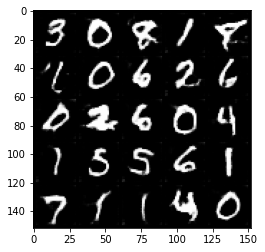

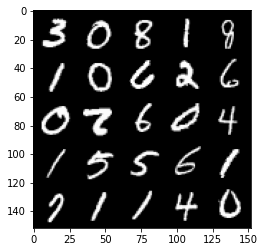

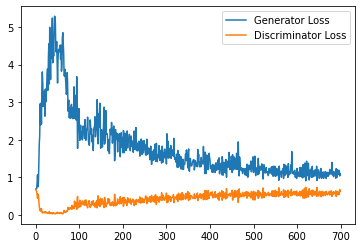

Step 14500: Generator loss: 1.0947702574729918, discriminator loss: 0.574781889975071


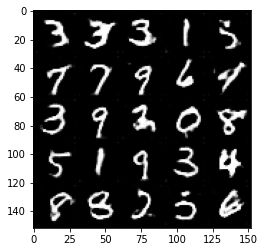

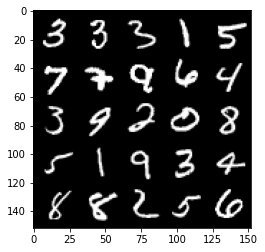

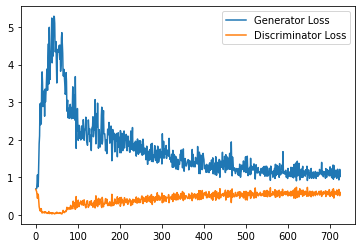

Step 15000: Generator loss: 1.0756359677314757, discriminator loss: 0.5842587923407555


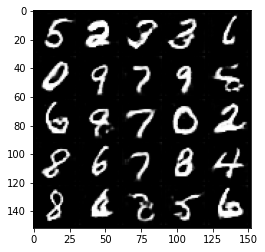

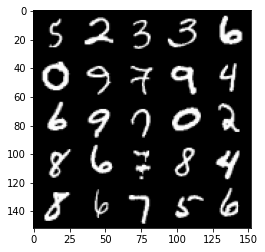

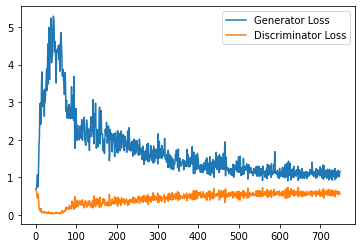

Step 15500: Generator loss: 1.0601531430482865, discriminator loss: 0.5859895083904266


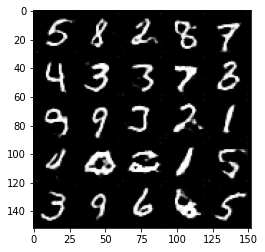

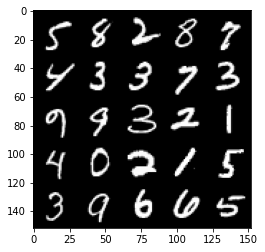

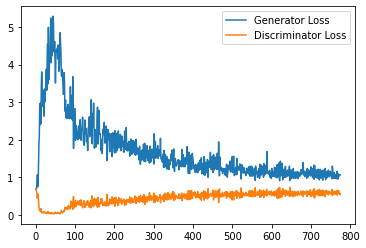

Step 16000: Generator loss: 1.043874440550804, discriminator loss: 0.5911052740216255


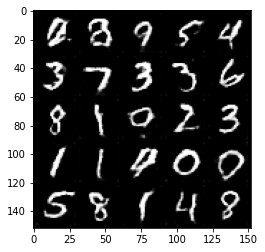

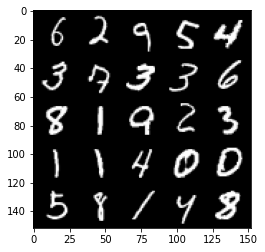

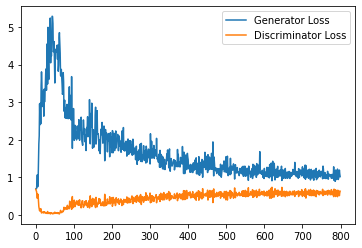

Step 16500: Generator loss: 1.0535692863464357, discriminator loss: 0.5871993834376336


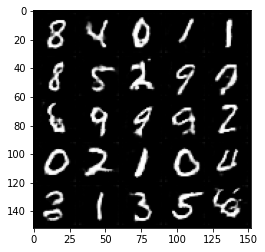

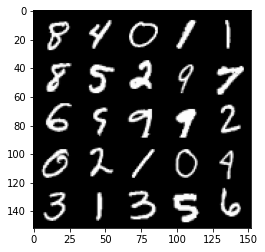

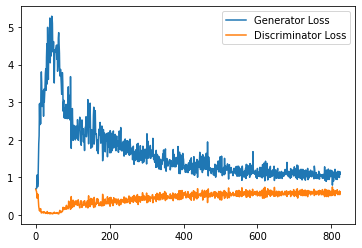

Step 17000: Generator loss: 1.045425066590309, discriminator loss: 0.5974644147753716


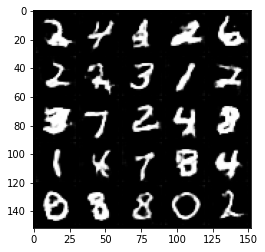

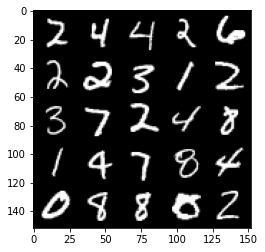

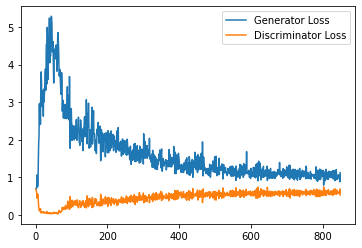

Step 17500: Generator loss: 1.0864892517328262, discriminator loss: 0.5896972687244415


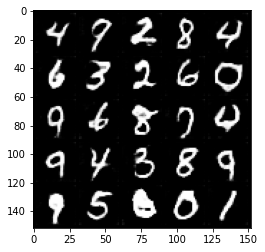

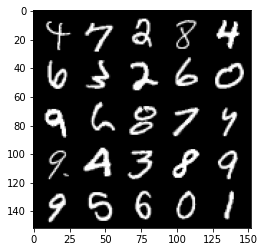

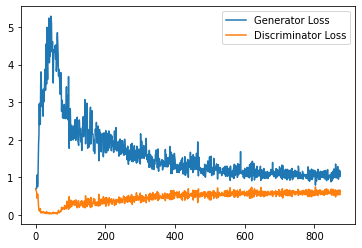

Step 18000: Generator loss: 1.0229720836877823, discriminator loss: 0.5912765471339225


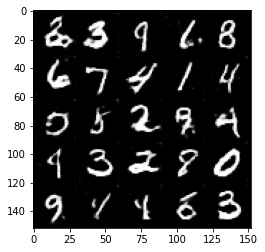

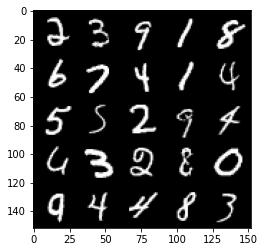

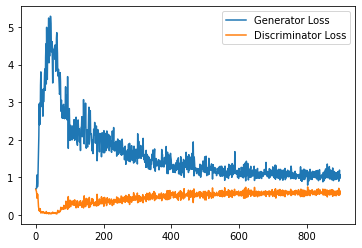

Step 18500: Generator loss: 1.020899500131607, discriminator loss: 0.5943365675807


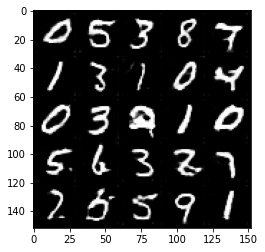

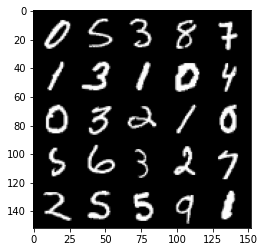

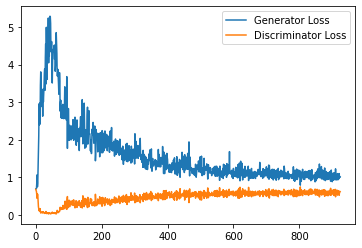

Step 19000: Generator loss: 1.009148254275322, discriminator loss: 0.5989373202323913


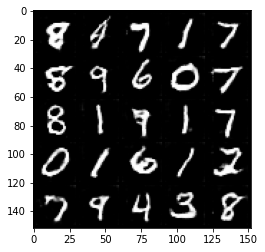

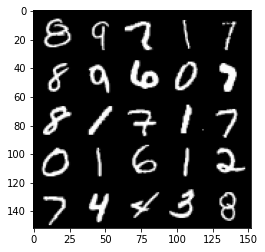

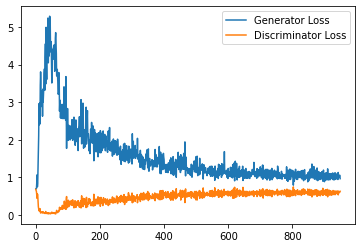

Step 19500: Generator loss: 1.0368753032684326, discriminator loss: 0.5923524990081787


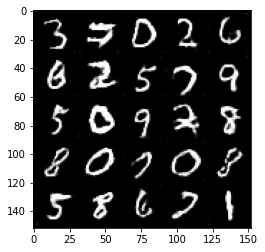

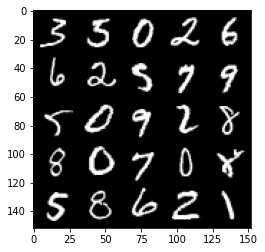

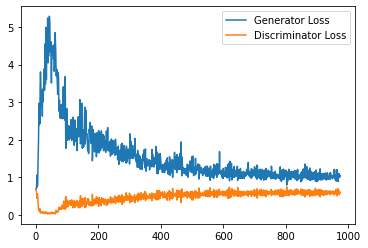

Step 20000: Generator loss: 1.001262803673744, discriminator loss: 0.6016245613694191


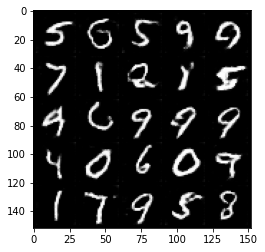

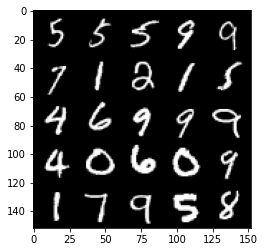

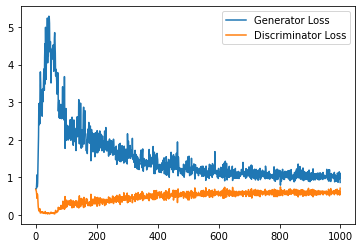

Step 20500: Generator loss: 1.0185204756259918, discriminator loss: 0.595636090517044


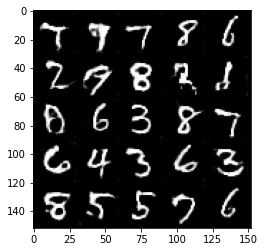

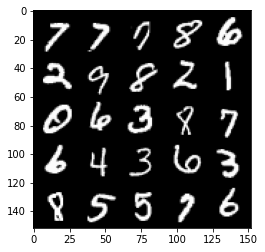

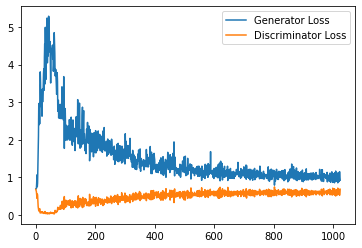

Step 21000: Generator loss: 1.0066017215251923, discriminator loss: 0.5975376818180084


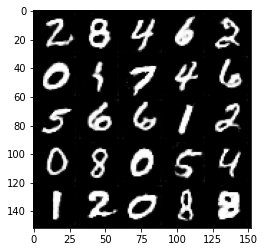

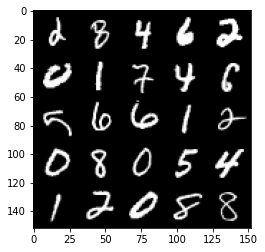

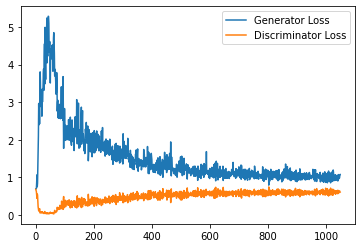

Step 21500: Generator loss: 1.0200906752347947, discriminator loss: 0.6024885500669479


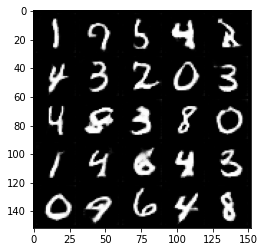

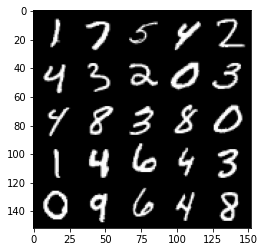

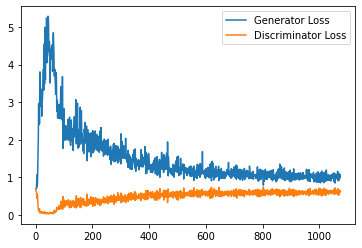

Step 22000: Generator loss: 1.0126911591291428, discriminator loss: 0.5995769693255425


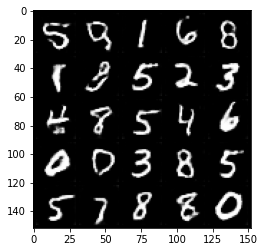

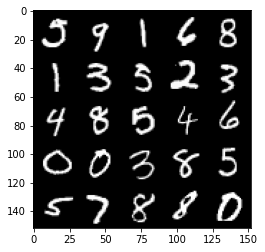

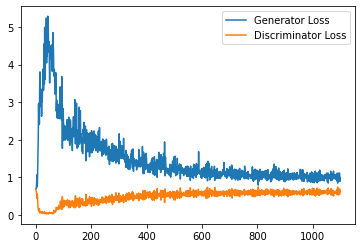

Step 22500: Generator loss: 0.9933113805055618, discriminator loss: 0.603003604888916


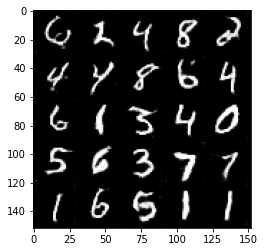

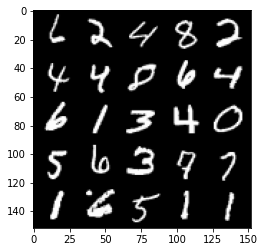

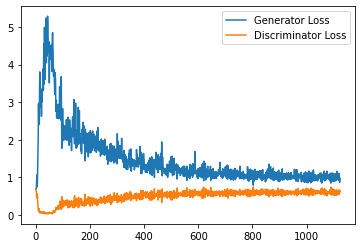

Step 23000: Generator loss: 0.9656734652519227, discriminator loss: 0.6046719512939454


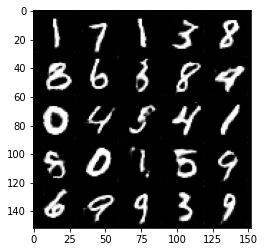

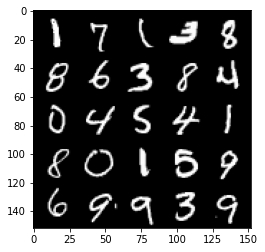

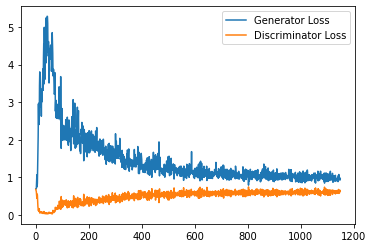

Step 23500: Generator loss: 0.968794842004776, discriminator loss: 0.5988355230093002


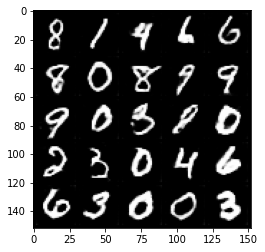

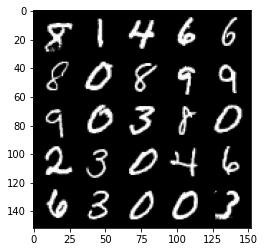

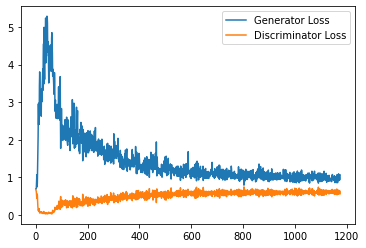

Step 24000: Generator loss: 0.9817287012338638, discriminator loss: 0.6050766575336456


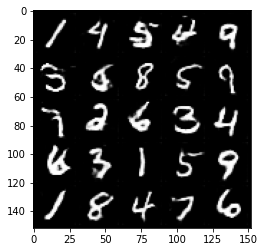

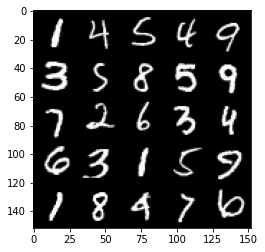

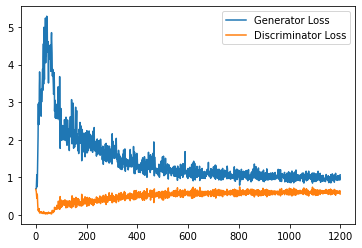

Step 24500: Generator loss: 0.9963388389348984, discriminator loss: 0.6057788692712783


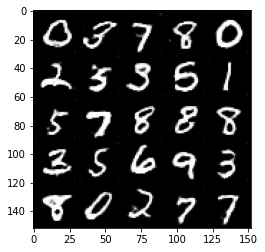

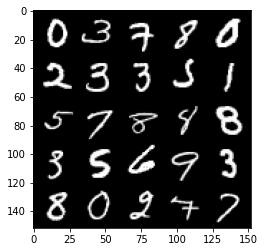

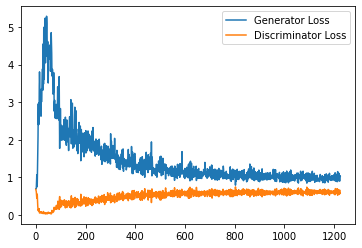

Step 25000: Generator loss: 0.9825549486875534, discriminator loss: 0.6086081805825233


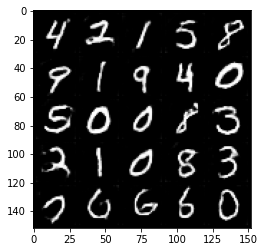

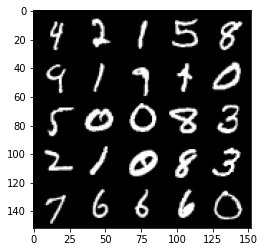

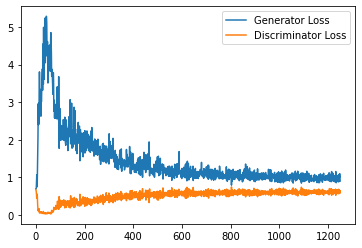

Step 25500: Generator loss: 0.9542759138345719, discriminator loss: 0.6075033149123192


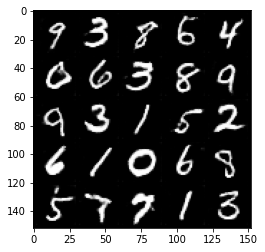

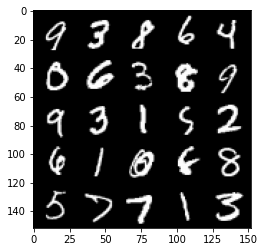

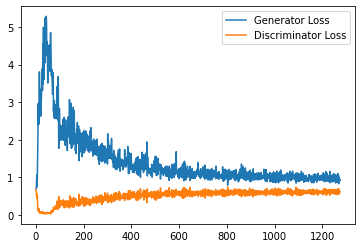

Step 26000: Generator loss: 0.9545896009206772, discriminator loss: 0.6049997562766075


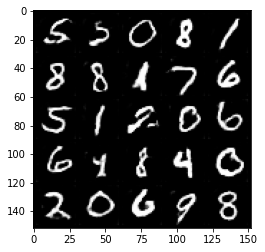

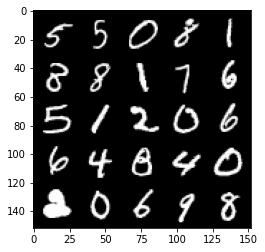

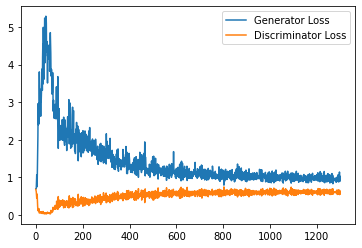

Step 26500: Generator loss: 0.9551343411207199, discriminator loss: 0.6083756159543992


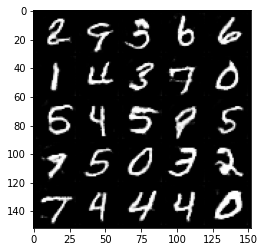

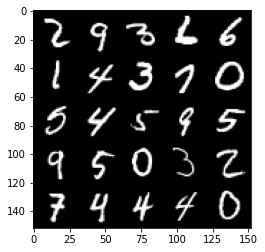

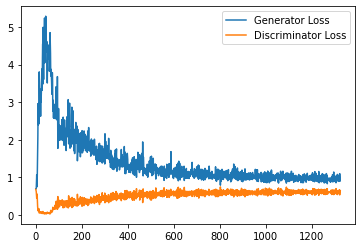

Step 27000: Generator loss: 0.9805406842231751, discriminator loss: 0.6059498708844185


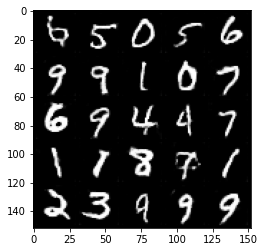

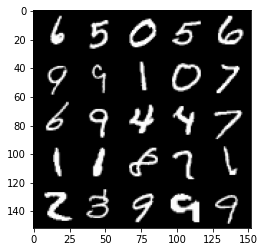

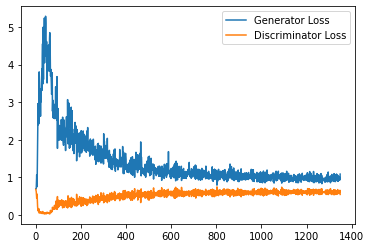

Step 27500: Generator loss: 0.9540330394506454, discriminator loss: 0.6118448375463486


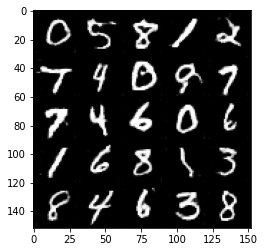

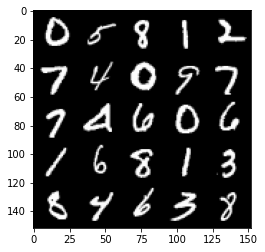

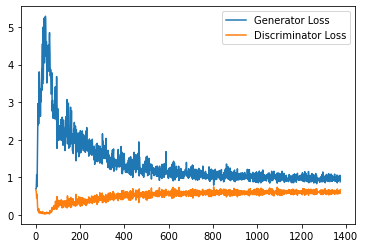

Step 28000: Generator loss: 0.9483791371583938, discriminator loss: 0.6094012800455093


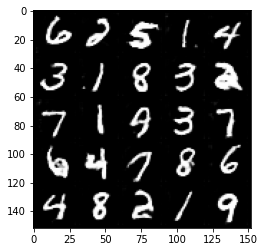

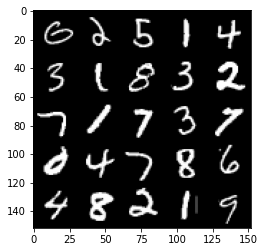

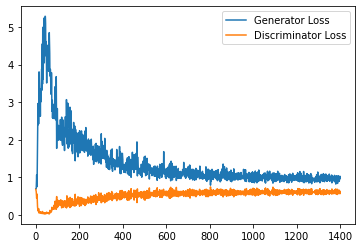

Step 28500: Generator loss: 0.9535847406387329, discriminator loss: 0.6113721913695336


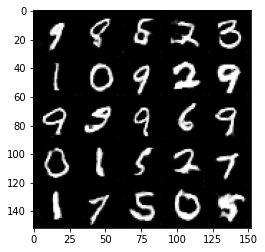

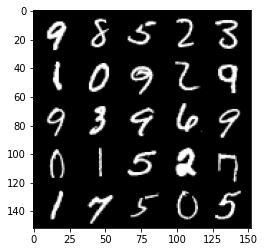

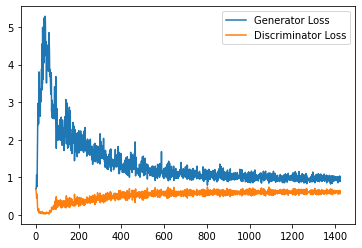

Step 29000: Generator loss: 0.9484365838766098, discriminator loss: 0.611213377058506


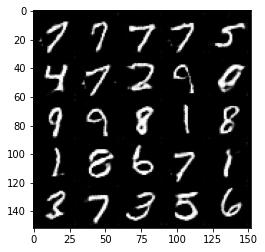

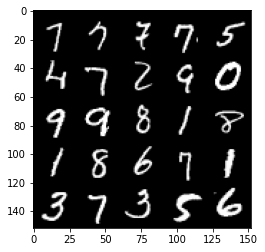

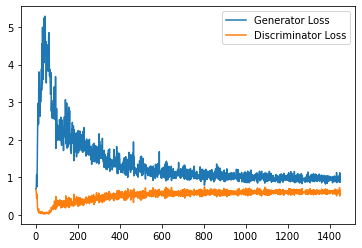

Step 29500: Generator loss: 0.9503843655586243, discriminator loss: 0.6144034292697906


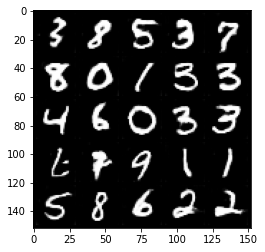

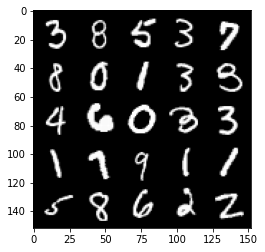

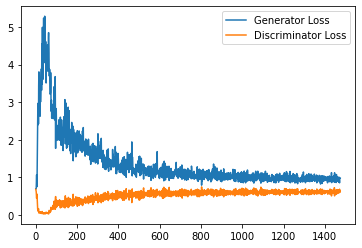

Step 30000: Generator loss: 0.9331440088748932, discriminator loss: 0.6126805911064148


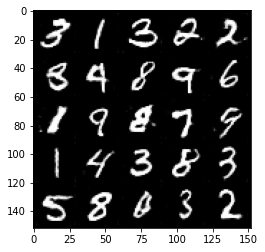

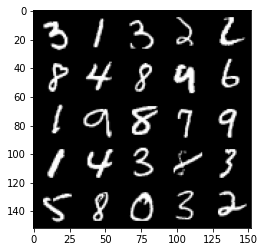

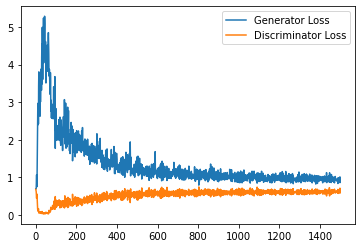

Step 30500: Generator loss: 0.9549185327291488, discriminator loss: 0.6106421640515327


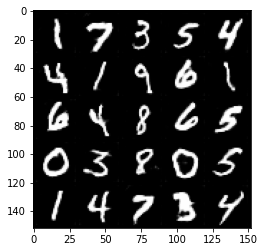

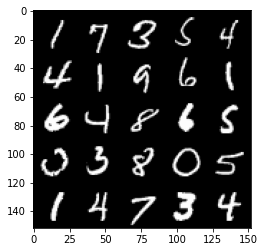

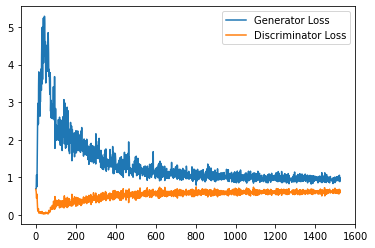

Step 31000: Generator loss: 0.9500171151161194, discriminator loss: 0.6125402157306671


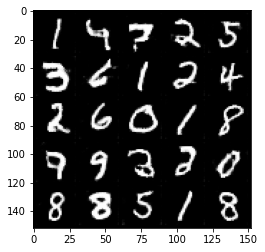

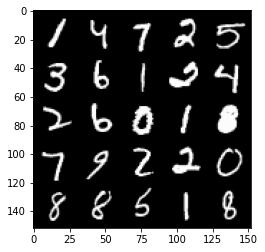

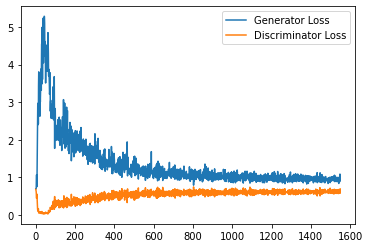

Step 31500: Generator loss: 0.9576982455253601, discriminator loss: 0.6075985373854638


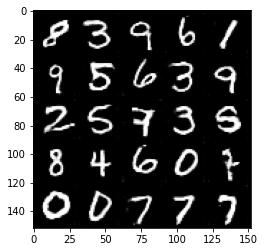

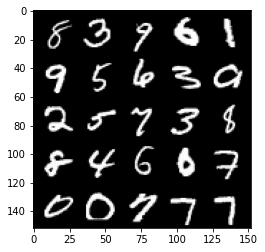

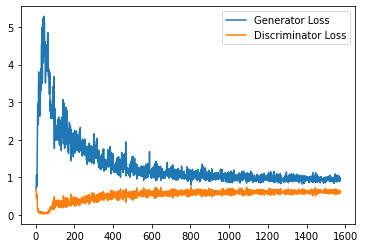

Step 32000: Generator loss: 0.9416260287761689, discriminator loss: 0.6117151063680649


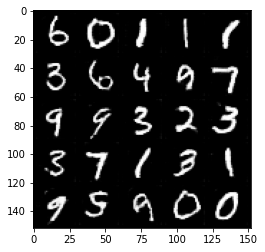

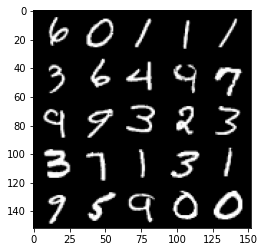

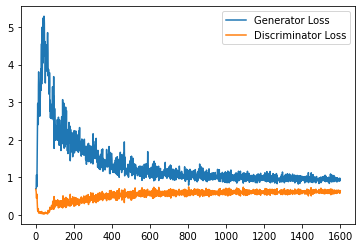

Step 32500: Generator loss: 0.9646771409511566, discriminator loss: 0.6105720483660698


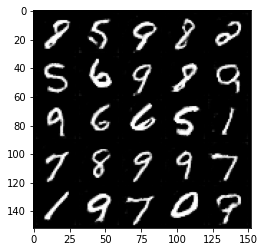

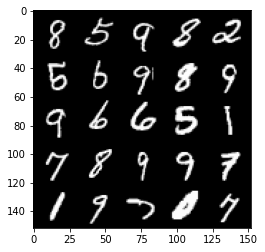

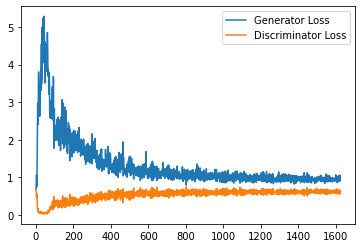

Step 33000: Generator loss: 0.9677116271257401, discriminator loss: 0.6068143739700317


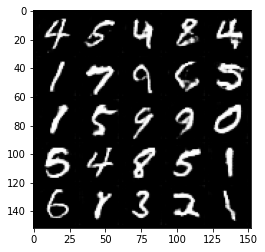

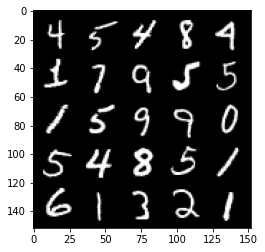

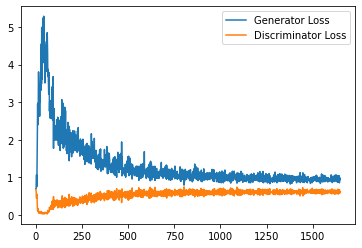

Step 33500: Generator loss: 0.9730837213993072, discriminator loss: 0.6102433506250381


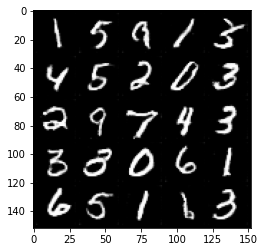

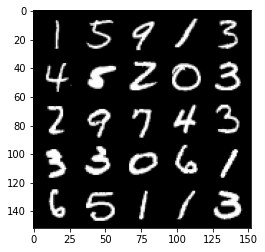

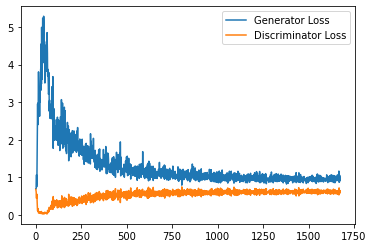

Step 34000: Generator loss: 0.9629922105073929, discriminator loss: 0.610771585047245


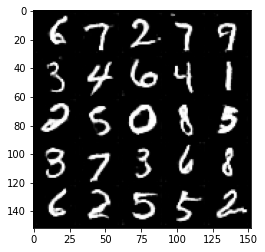

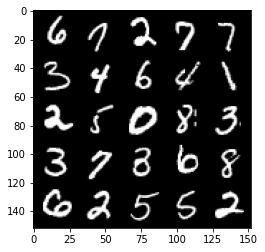

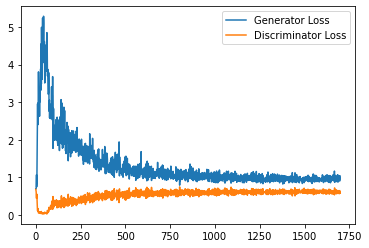

Step 34500: Generator loss: 0.959383138537407, discriminator loss: 0.6096640157699585


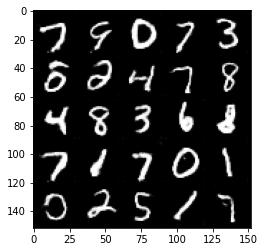

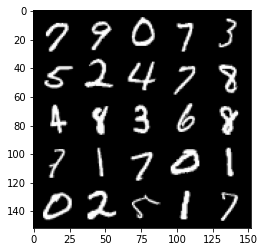

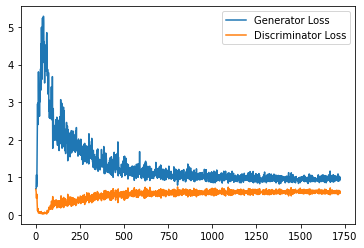

Step 35000: Generator loss: 0.9619180495738984, discriminator loss: 0.6103167663812638


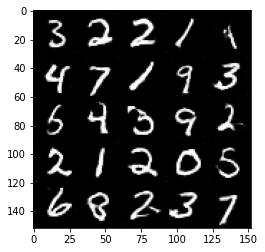

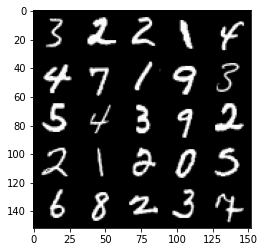

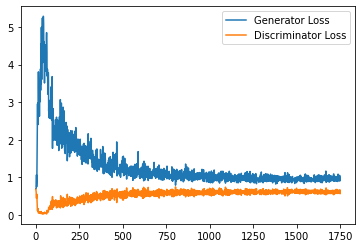

Step 35500: Generator loss: 0.9679848030805588, discriminator loss: 0.6088286274671555


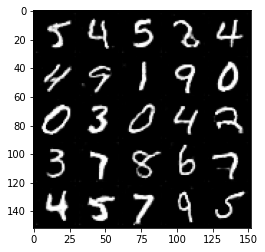

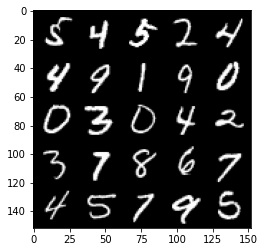

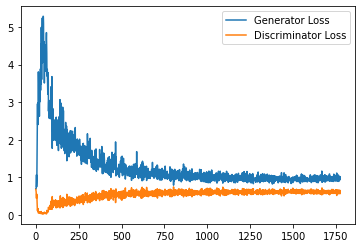

Step 36000: Generator loss: 0.9674108887910843, discriminator loss: 0.6096690573096275


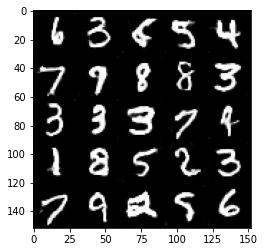

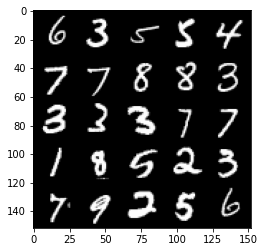

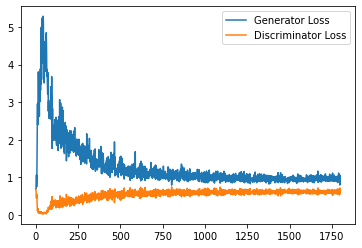

Step 36500: Generator loss: 0.9607932707071304, discriminator loss: 0.6106816308498383


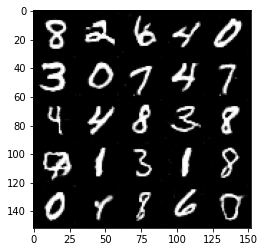

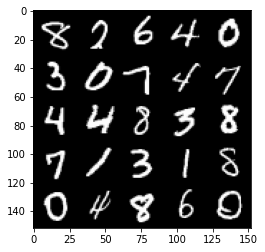

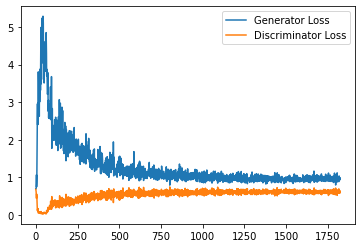

Step 37000: Generator loss: 0.9609288054704667, discriminator loss: 0.6159406986832618


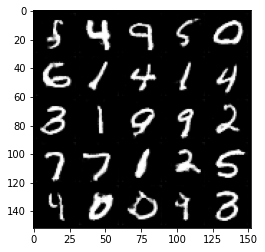

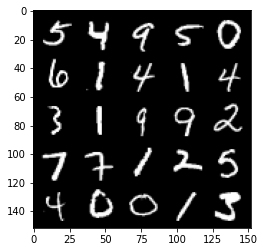

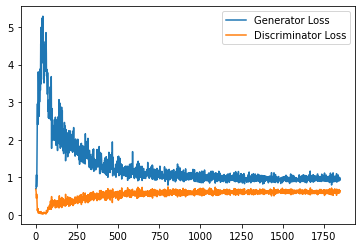

Step 37500: Generator loss: 0.9659993717670441, discriminator loss: 0.6110617769956589


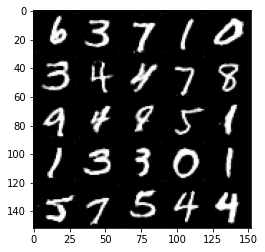

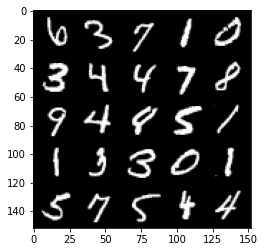

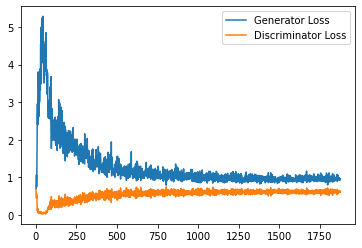

Step 38000: Generator loss: 0.9477963694334031, discriminator loss: 0.6081338389515877


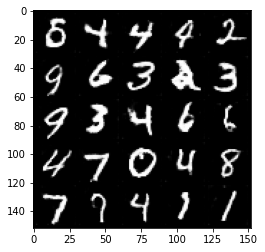

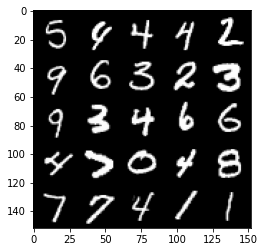

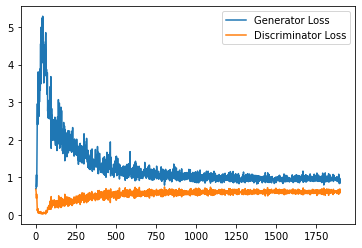

Step 38500: Generator loss: 0.9634703106880188, discriminator loss: 0.602667209327221


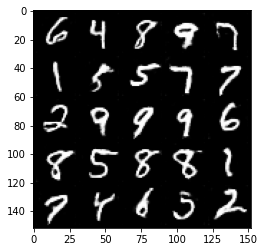

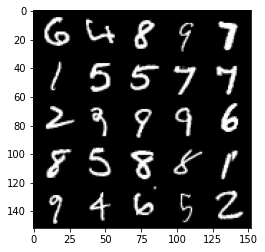

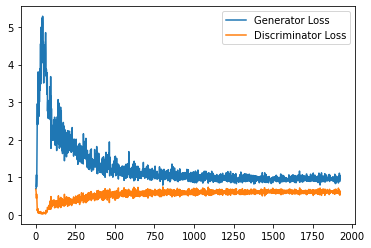

Step 39000: Generator loss: 0.963353447675705, discriminator loss: 0.60758318567276


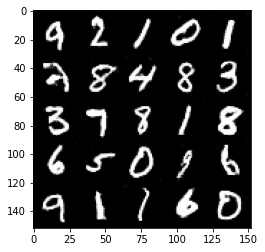

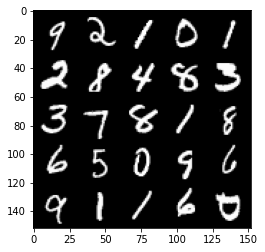

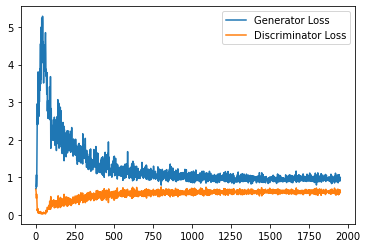

Step 39500: Generator loss: 0.9637510488033295, discriminator loss: 0.6032744344472886


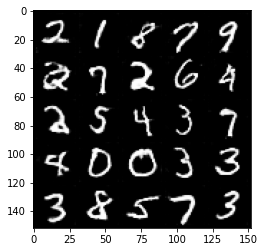

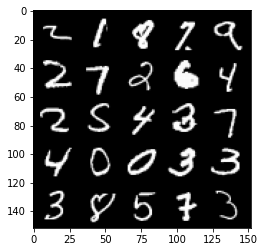

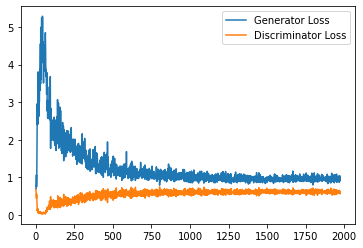

Step 40000: Generator loss: 0.9533871085643768, discriminator loss: 0.6054862169027329


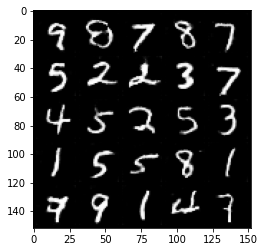

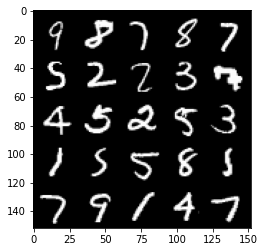

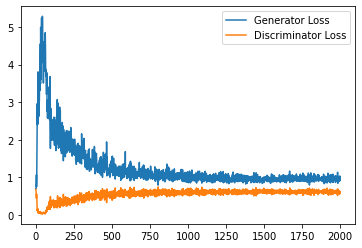

Step 40500: Generator loss: 0.9491361111402512, discriminator loss: 0.6058509006500244


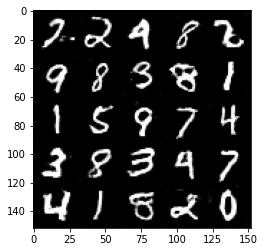

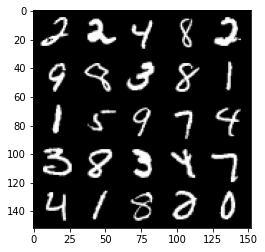

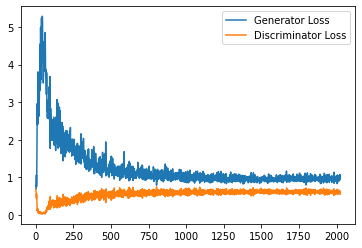

Step 41000: Generator loss: 0.9867558046579361, discriminator loss: 0.599565063238144


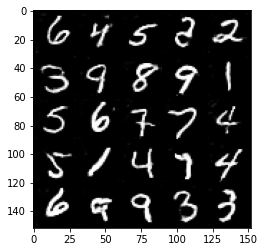

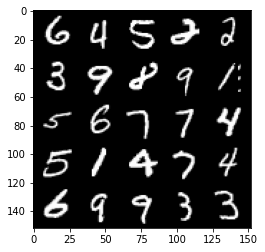

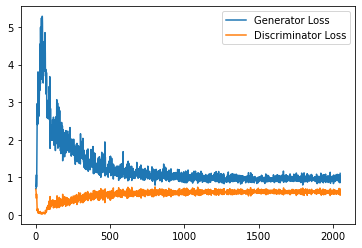

Step 41500: Generator loss: 0.9430732984542847, discriminator loss: 0.6088171226382255


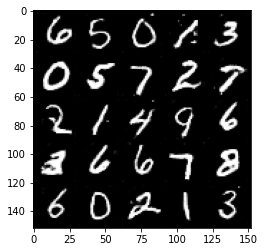

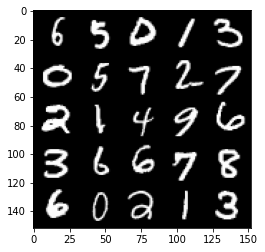

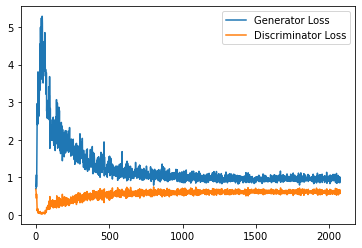

Step 42000: Generator loss: 0.9640176963806152, discriminator loss: 0.6052498174905777


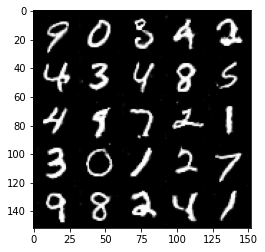

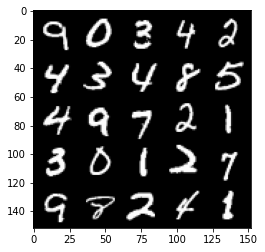

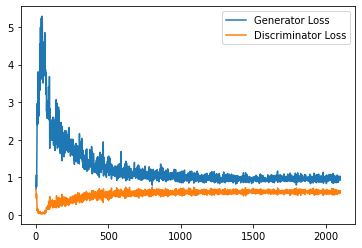

Step 42500: Generator loss: 0.9735701413154602, discriminator loss: 0.6055586661100387


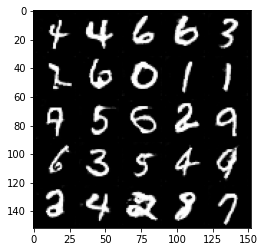

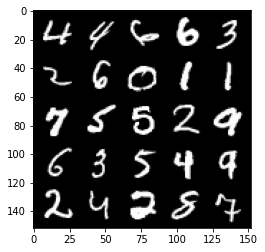

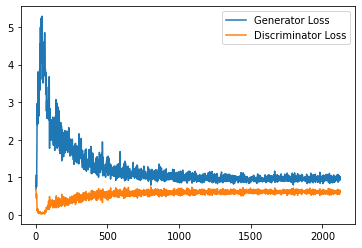

Step 43000: Generator loss: 0.9757939931154251, discriminator loss: 0.6017058512568474


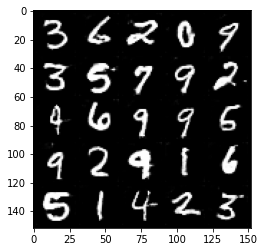

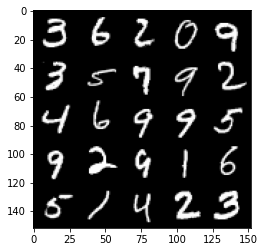

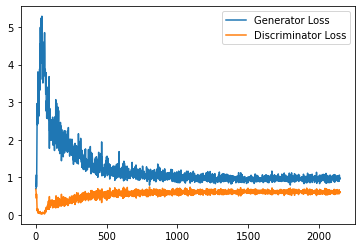

Step 43500: Generator loss: 0.9608252784013748, discriminator loss: 0.6009663525223732


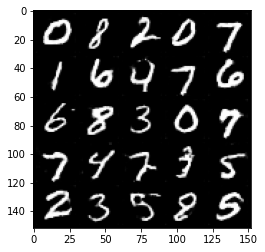

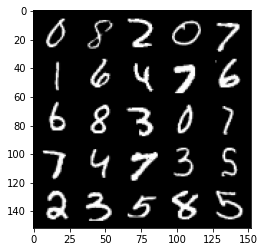

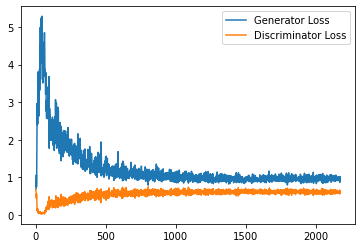

Step 44000: Generator loss: 0.9750682495832443, discriminator loss: 0.5986685535311699


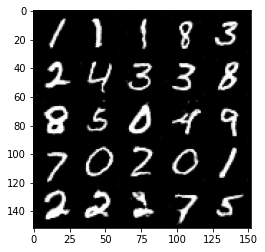

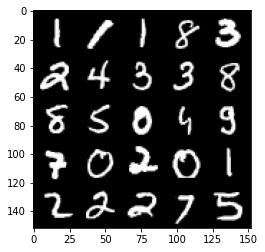

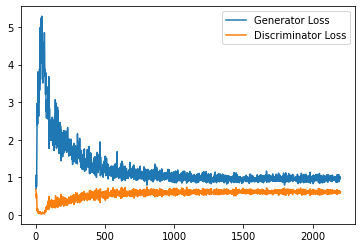

Step 44500: Generator loss: 1.0031333714723587, discriminator loss: 0.6028449459671974


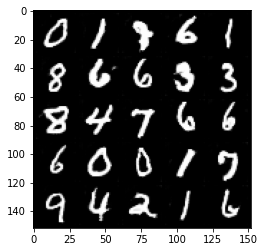

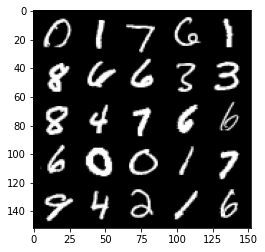

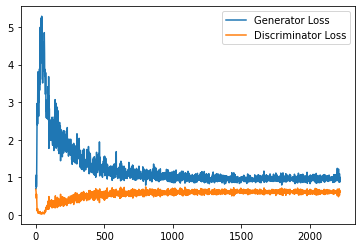

Step 45000: Generator loss: 0.9551742436885834, discriminator loss: 0.6002048690319062


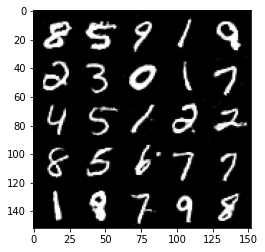

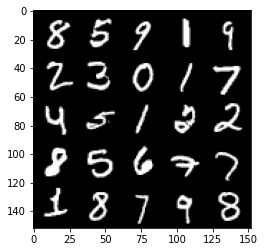

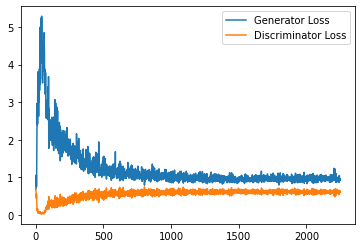

Step 45500: Generator loss: 0.9789333909749984, discriminator loss: 0.5967706548571586


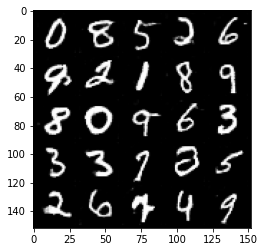

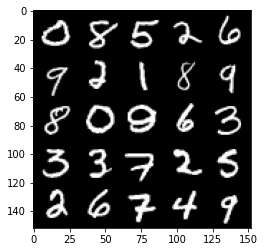

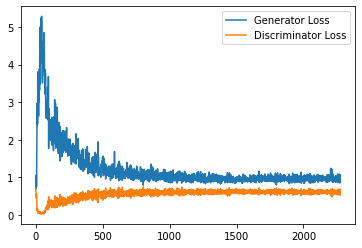

Step 46000: Generator loss: 0.9632804979085923, discriminator loss: 0.6009109607934952


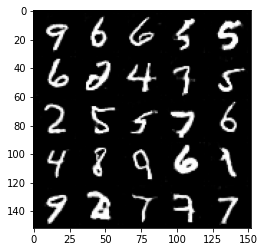

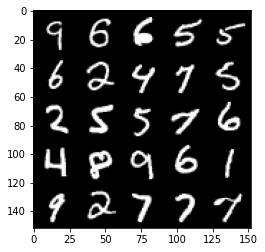

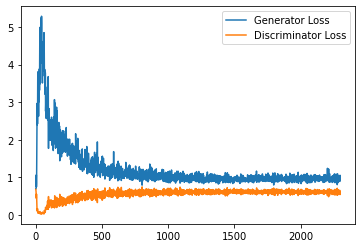

Step 46500: Generator loss: 0.9639479482173919, discriminator loss: 0.6026723538041114


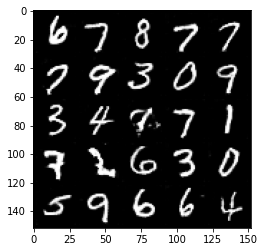

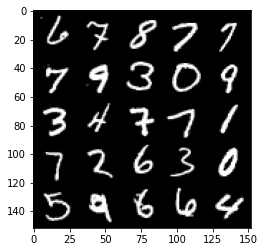

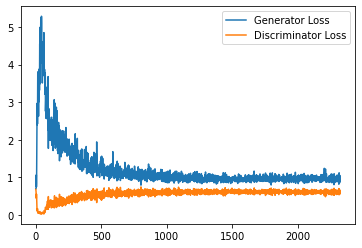

Step 47000: Generator loss: 0.9808231836557388, discriminator loss: 0.5971437504291535


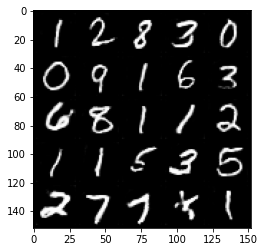

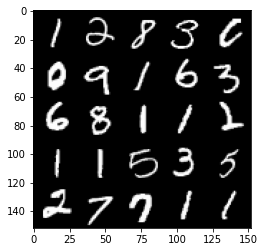

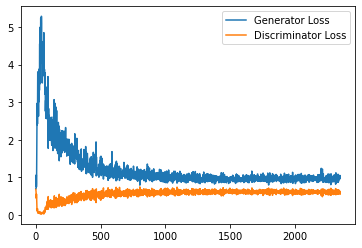

Step 47500: Generator loss: 0.9695695098638535, discriminator loss: 0.6013315739035606


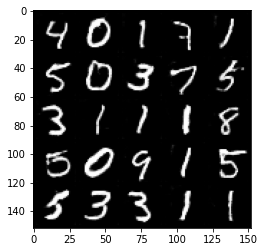

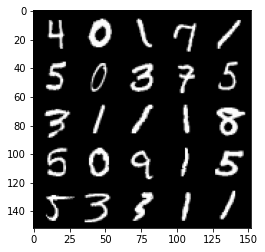

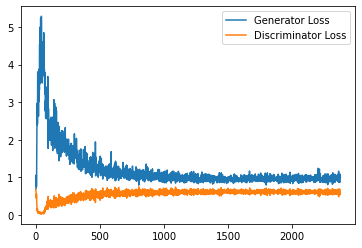

Step 48000: Generator loss: 0.978829130768776, discriminator loss: 0.601346262216568


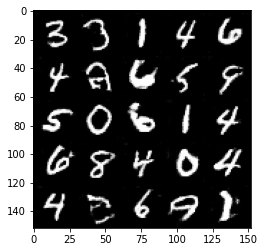

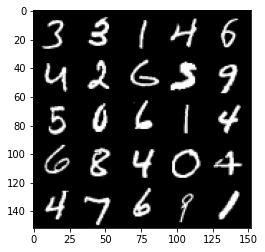

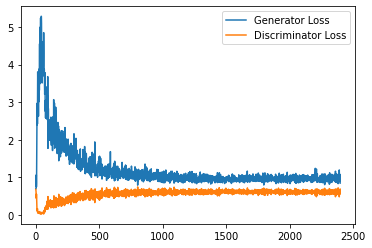

Step 48500: Generator loss: 0.9848690040111542, discriminator loss: 0.5922314147353173


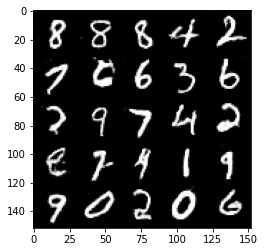

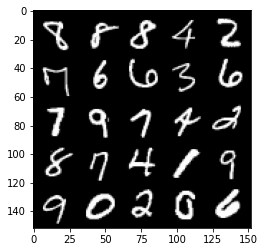

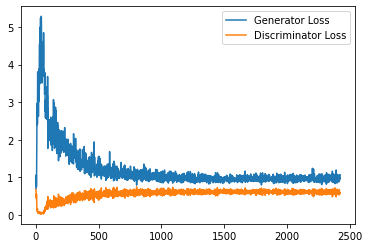

Step 49000: Generator loss: 0.9772038139104843, discriminator loss: 0.5968911157250404


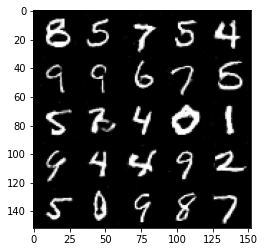

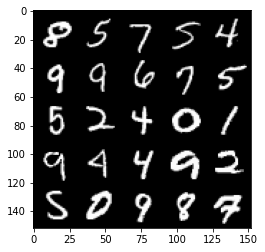

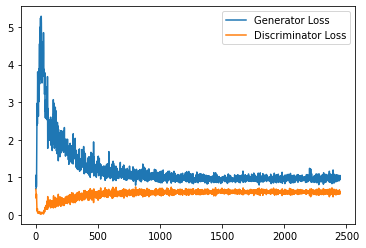

Step 49500: Generator loss: 0.9827388961315155, discriminator loss: 0.5964825283885002


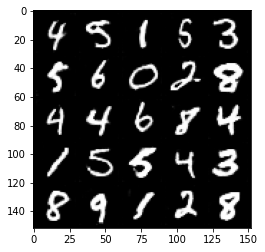

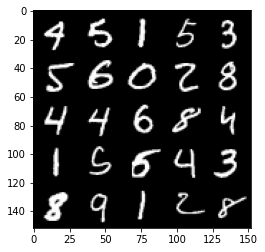

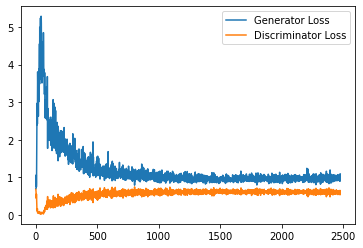

Step 50000: Generator loss: 0.9861807514429093, discriminator loss: 0.5978376705050469


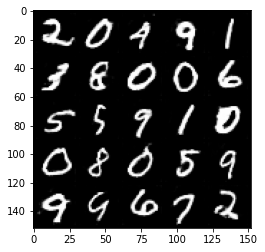

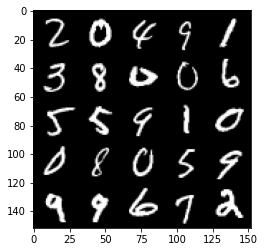

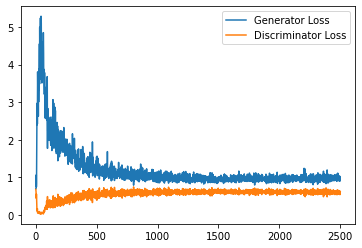

Step 50500: Generator loss: 0.980243440747261, discriminator loss: 0.5953560690879822


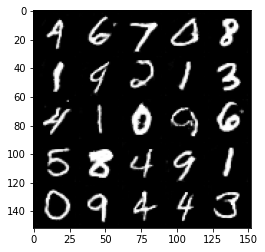

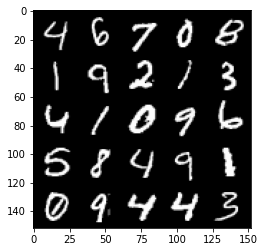

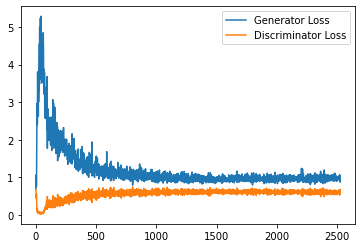

Step 51000: Generator loss: 0.9741424666643143, discriminator loss: 0.5968784114122391


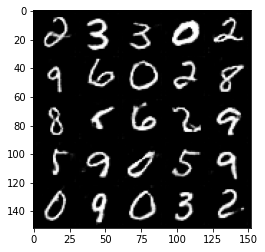

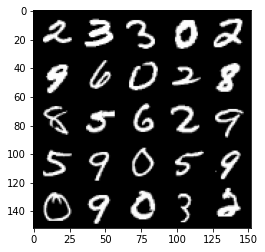

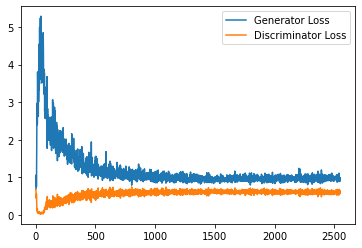

Step 51500: Generator loss: 0.9815355741977692, discriminator loss: 0.5961176731586456


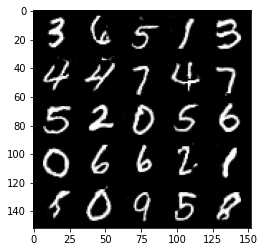

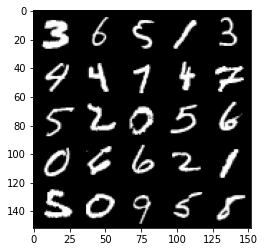

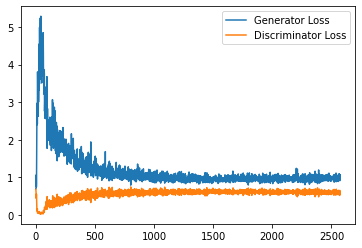

Step 52000: Generator loss: 0.9878281363248825, discriminator loss: 0.5971913539171219


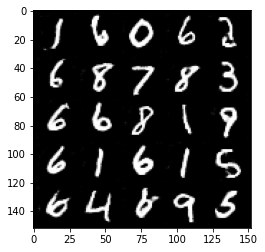

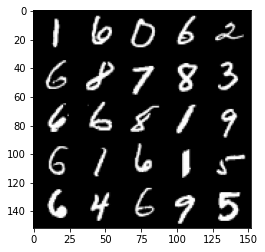

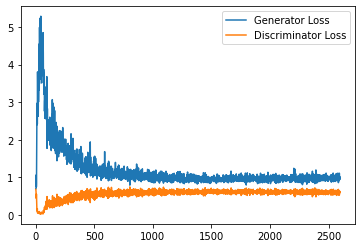

Step 52500: Generator loss: 0.9945087757110596, discriminator loss: 0.5899574776291847


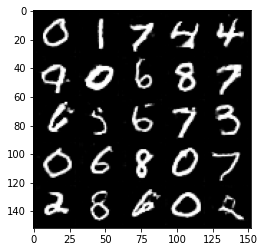

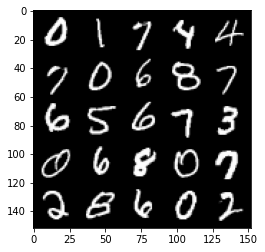

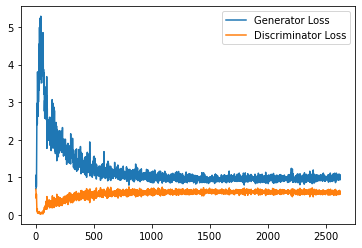

Step 53000: Generator loss: 0.9959451819658279, discriminator loss: 0.5940521906018257


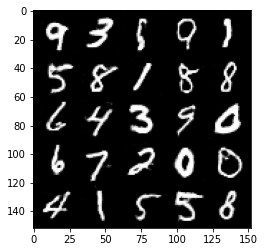

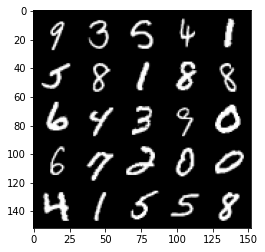

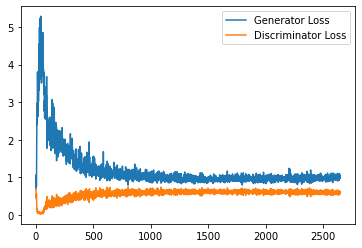

Step 53500: Generator loss: 0.9886598631143569, discriminator loss: 0.5915427985787391


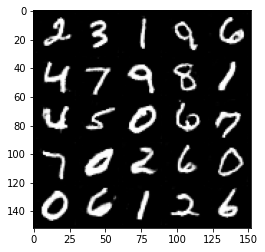

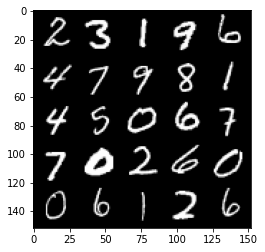

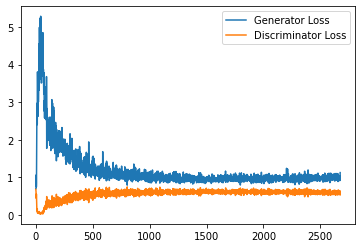

Step 54000: Generator loss: 0.976571860074997, discriminator loss: 0.5903026040196419


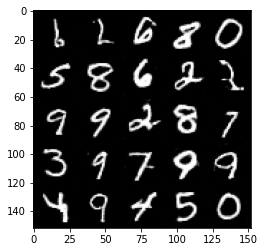

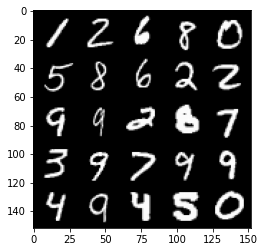

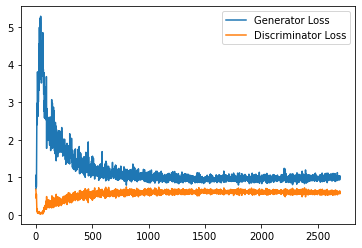

Step 54500: Generator loss: 0.9976204909086227, discriminator loss: 0.5932272294759751


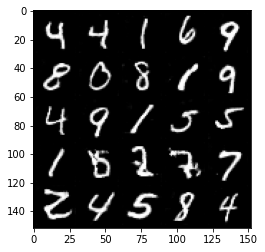

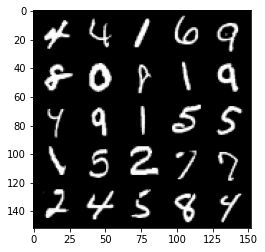

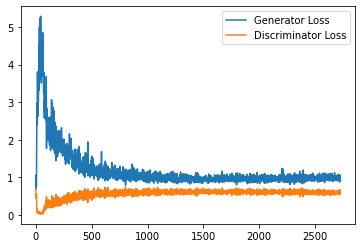

Step 55000: Generator loss: 0.9690557056665421, discriminator loss: 0.5990150740742683


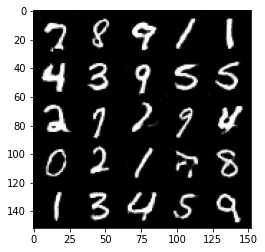

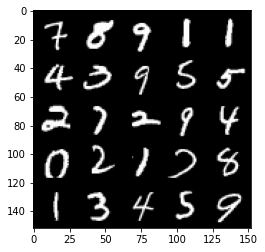

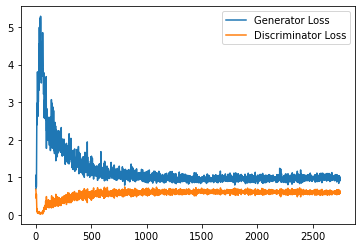

Step 55500: Generator loss: 0.9939453738927841, discriminator loss: 0.5881224346160888


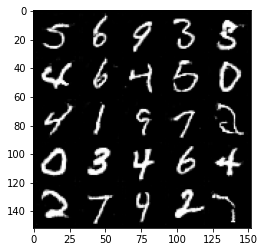

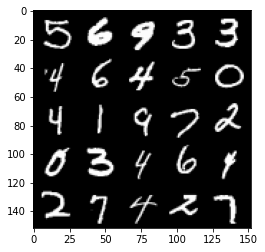

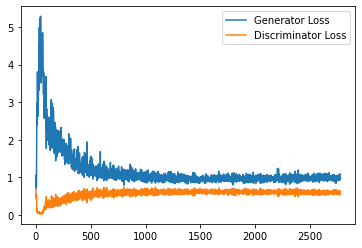

Step 56000: Generator loss: 0.9889520987272262, discriminator loss: 0.6003301563858986


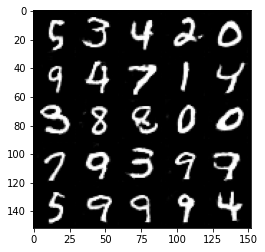

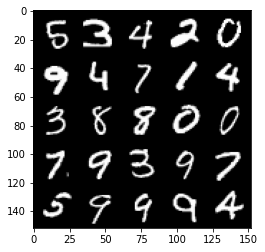

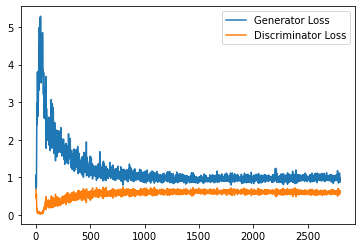

Step 56500: Generator loss: 0.981178284406662, discriminator loss: 0.5907340365648269


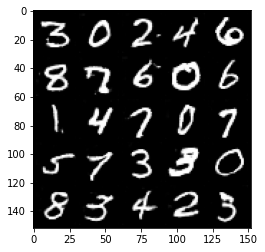

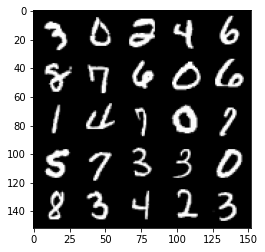

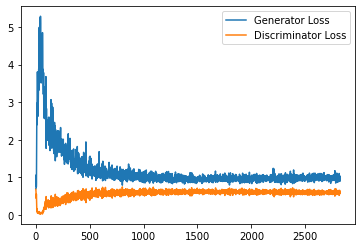

Step 57000: Generator loss: 1.0038648456335069, discriminator loss: 0.5922494595050811


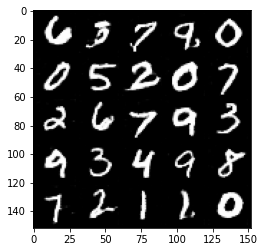

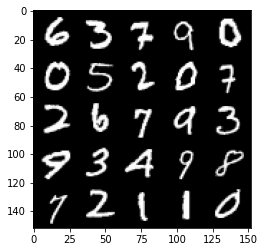

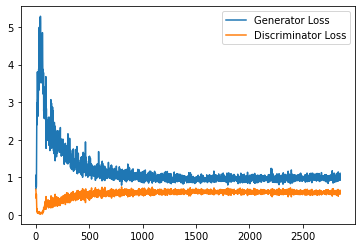

Step 57500: Generator loss: 0.9947414041757584, discriminator loss: 0.5889879985451698


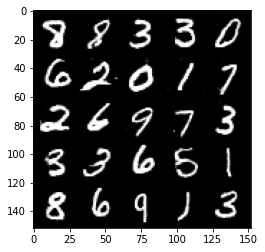

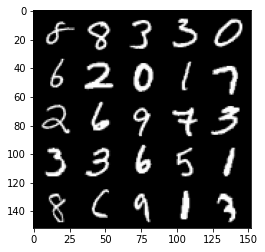

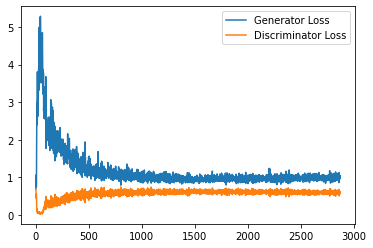

Step 58000: Generator loss: 0.9786883418560028, discriminator loss: 0.5875052209496499


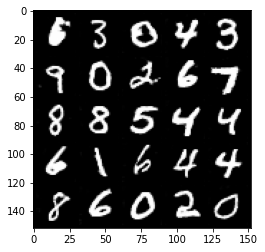

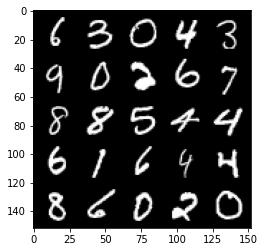

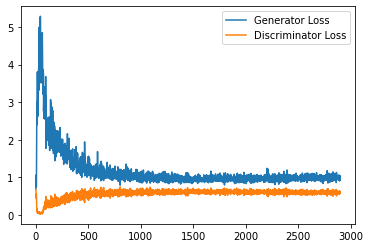

Step 58500: Generator loss: 1.0063998955488205, discriminator loss: 0.5891669800281525


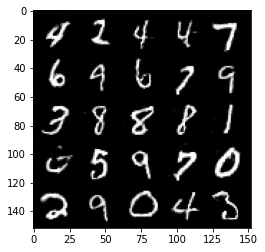

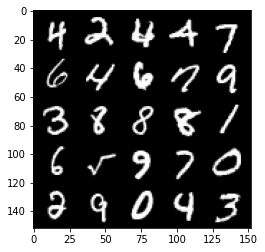

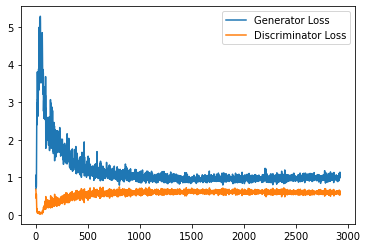

Step 59000: Generator loss: 0.9953103634119034, discriminator loss: 0.5918039125204086


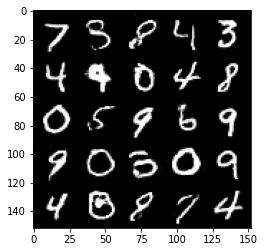

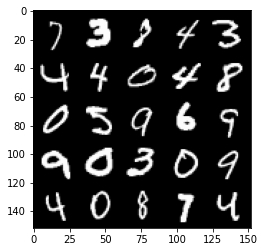

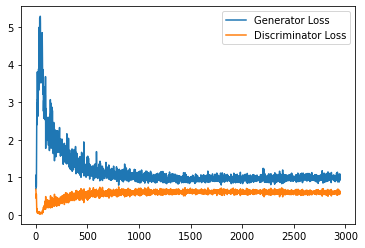

Step 59500: Generator loss: 1.0033294641971588, discriminator loss: 0.5867338163852691


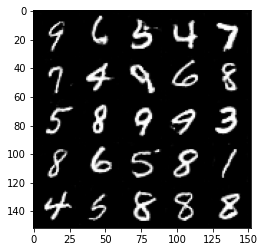

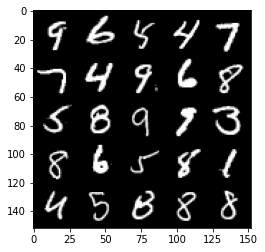

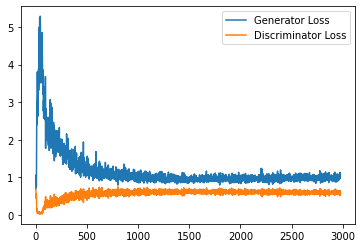

Step 60000: Generator loss: 0.9951096692085266, discriminator loss: 0.5927010157704353


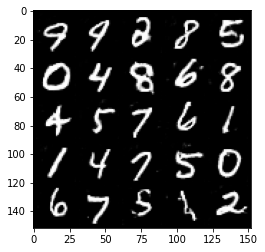

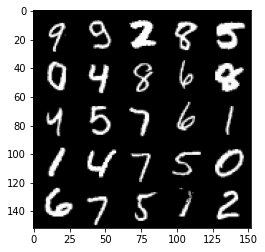

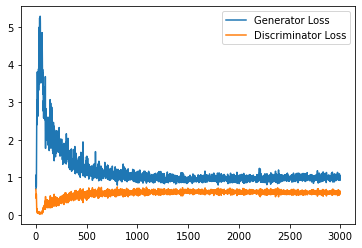

Step 60500: Generator loss: 0.9984826340675353, discriminator loss: 0.5902093653082847


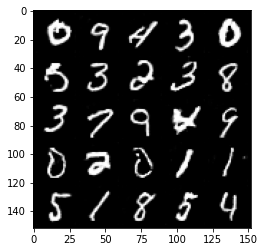

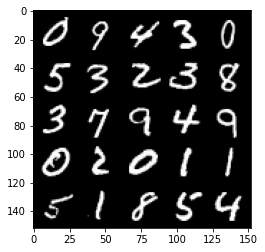

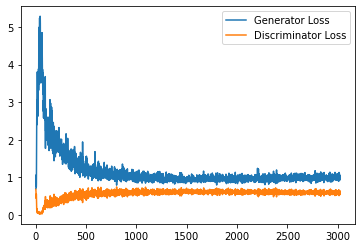

Step 61000: Generator loss: 0.9877112989425659, discriminator loss: 0.5907025352716446


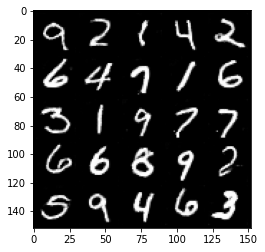

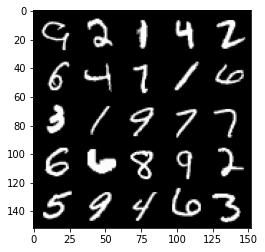

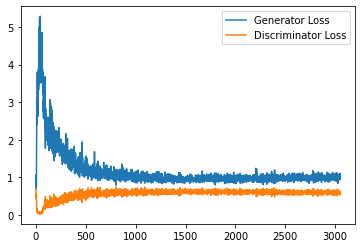

Step 61500: Generator loss: 1.0043963947296142, discriminator loss: 0.592802277982235


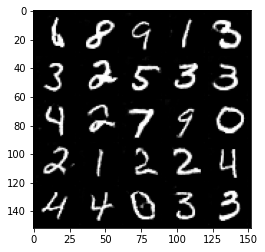

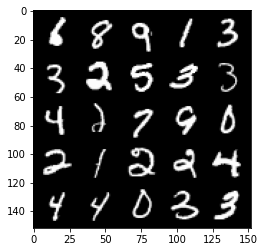

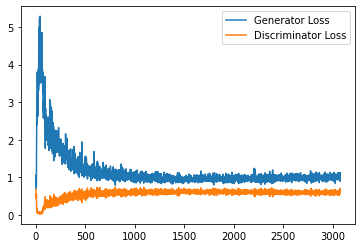

Step 62000: Generator loss: 1.0024850898981095, discriminator loss: 0.5908664075732231


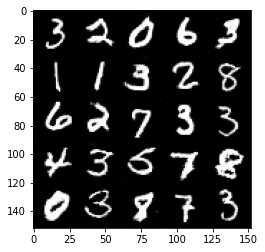

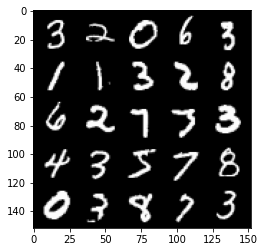

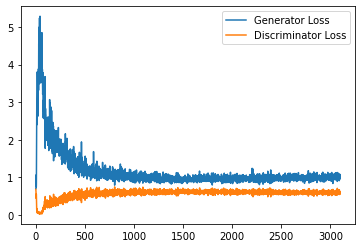

Step 62500: Generator loss: 0.9982689574956894, discriminator loss: 0.586439676463604


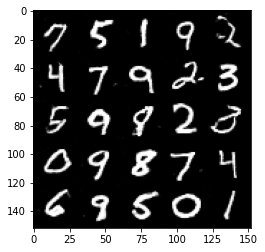

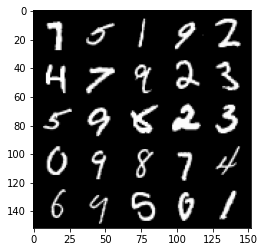

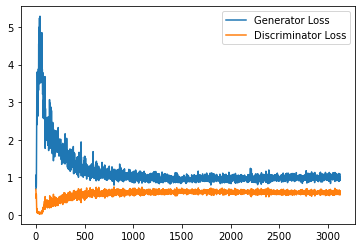

Step 63000: Generator loss: 0.9823791521787644, discriminator loss: 0.5886496537327767


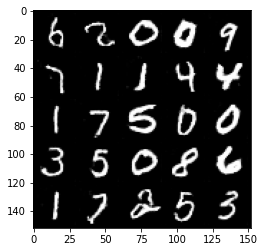

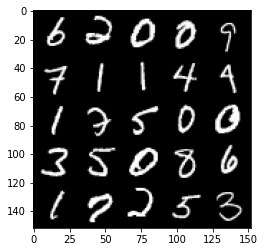

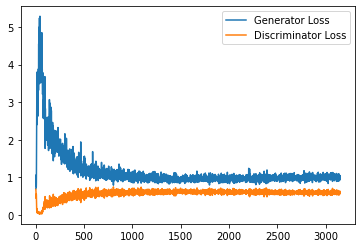

Step 63500: Generator loss: 1.0024794818162919, discriminator loss: 0.5856903375387191


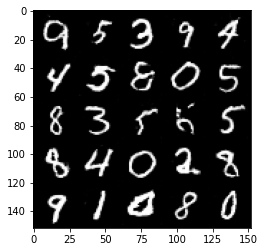

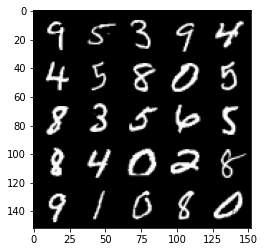

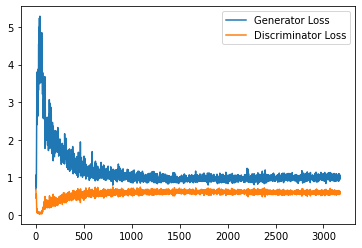

Step 64000: Generator loss: 1.020565770983696, discriminator loss: 0.5874735659360886


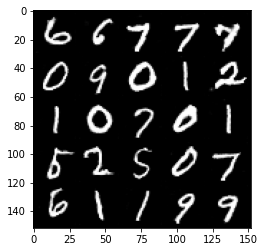

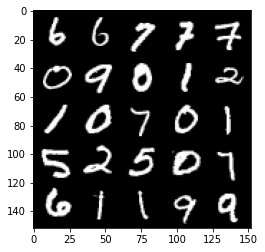

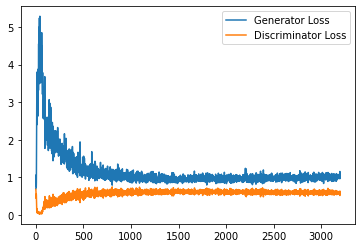

Step 64500: Generator loss: 1.007445086479187, discriminator loss: 0.5881220102906227


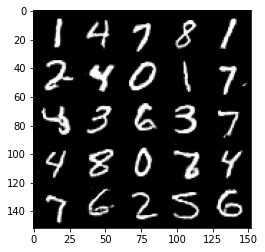

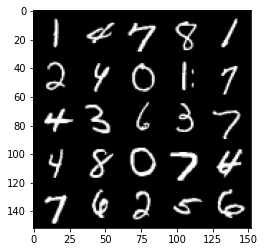

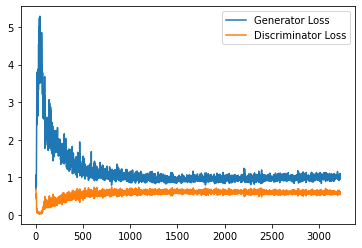

Step 65000: Generator loss: 1.0053050744533538, discriminator loss: 0.5908609901070595


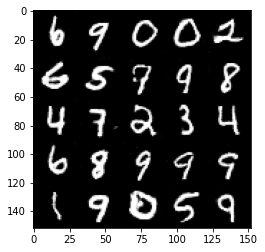

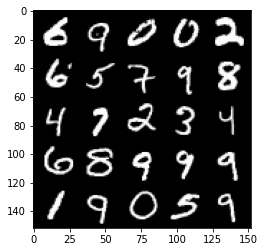

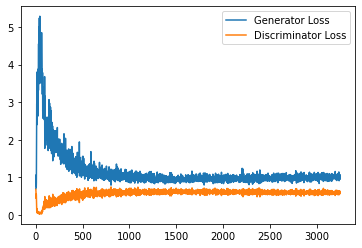

Step 65500: Generator loss: 1.0043923161029815, discriminator loss: 0.5918450116515159


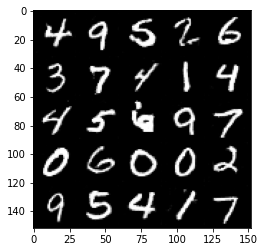

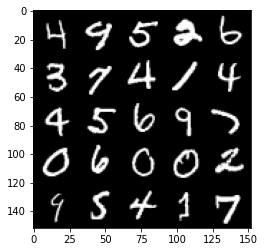

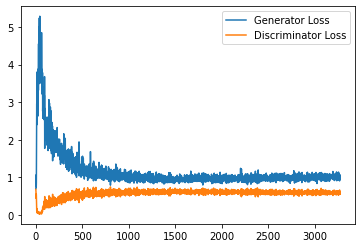

Step 66000: Generator loss: 0.9909069484472275, discriminator loss: 0.5944670976996422


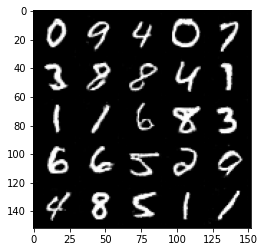

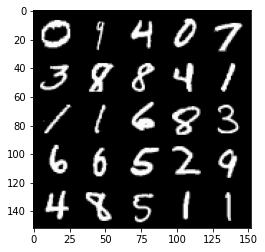

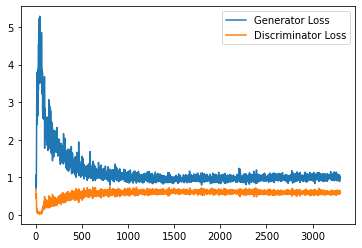

Step 66500: Generator loss: 0.9844463428258896, discriminator loss: 0.5935383737683296


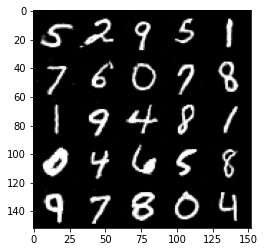

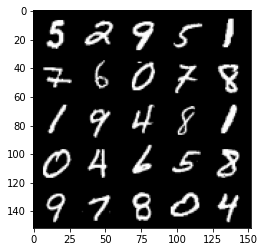

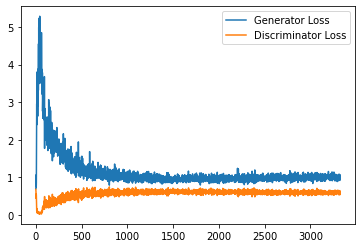

Step 67000: Generator loss: 0.9837420984506607, discriminator loss: 0.5967508307695388


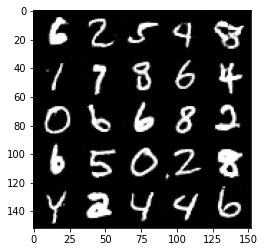

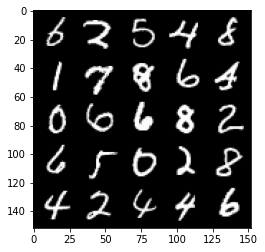

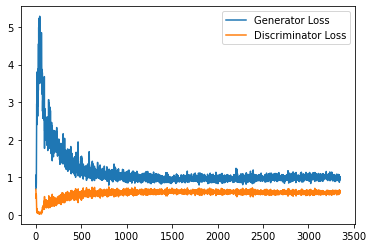

Step 67500: Generator loss: 0.9953759739398956, discriminator loss: 0.5930409718155861


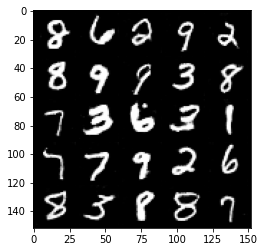

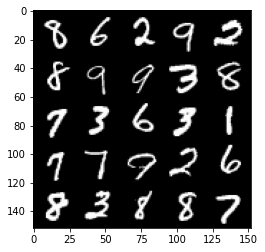

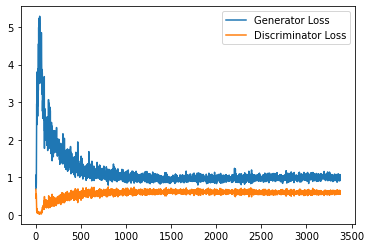

Step 68000: Generator loss: 0.9880727728605271, discriminator loss: 0.5946935583949089


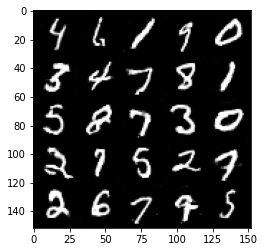

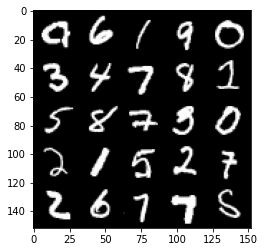

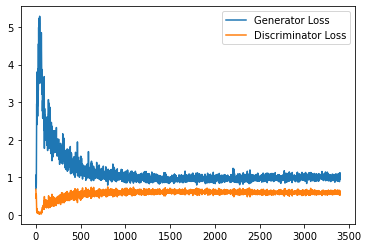

Step 68500: Generator loss: 0.9949811933040619, discriminator loss: 0.5965944302082061


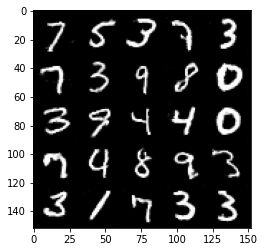

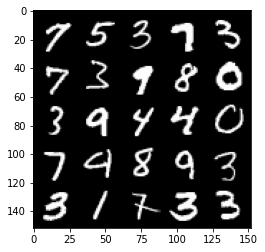

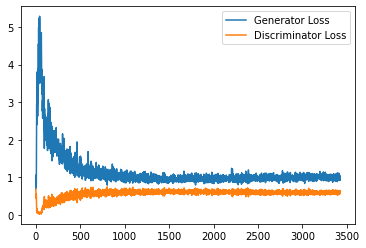

Step 69000: Generator loss: 0.986195219039917, discriminator loss: 0.5964485543966294


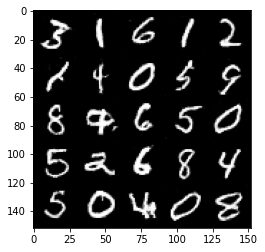

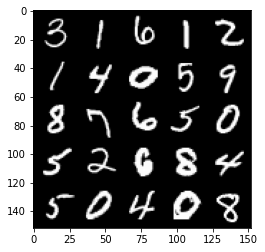

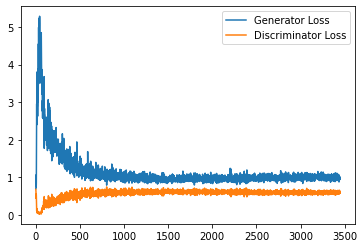

Step 69500: Generator loss: 0.9884132466316223, discriminator loss: 0.5975709980130196


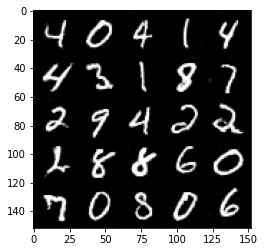

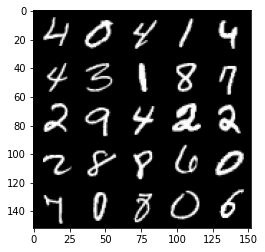

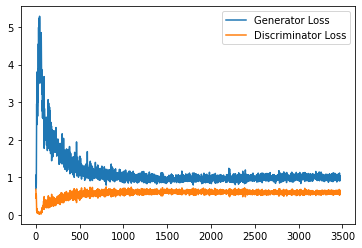

Step 70000: Generator loss: 1.0089481875896453, discriminator loss: 0.5957786211371422


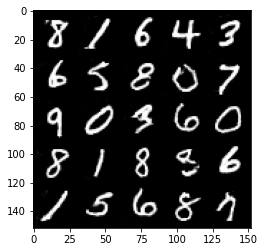

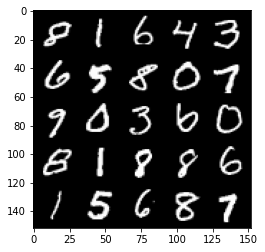

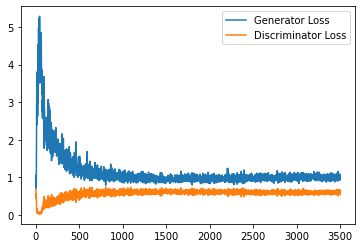

Step 70500: Generator loss: 0.9874117739200592, discriminator loss: 0.5966163320541382


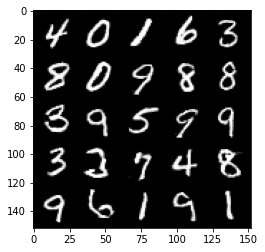

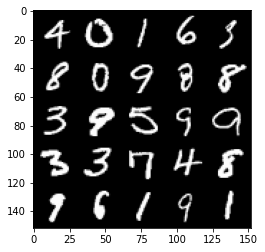

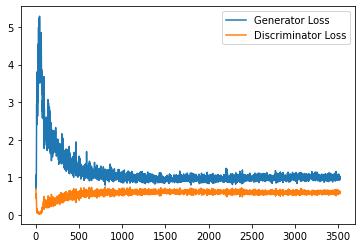

Step 71000: Generator loss: 0.976919372677803, discriminator loss: 0.6010184494853019


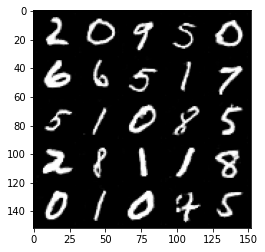

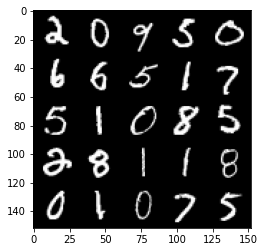

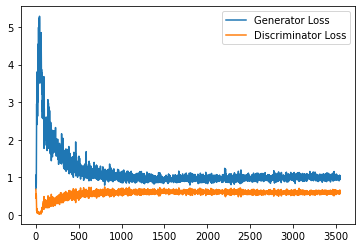

Step 71500: Generator loss: 0.9746127443313599, discriminator loss: 0.6022986108064652


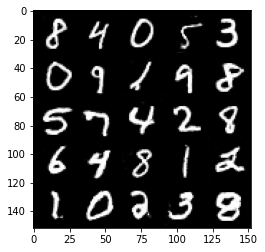

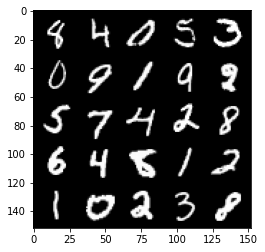

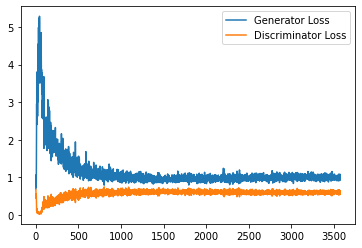

Step 72000: Generator loss: 0.9696698118448257, discriminator loss: 0.6030302048921585


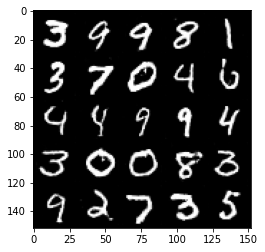

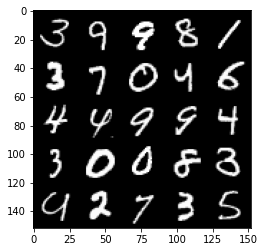

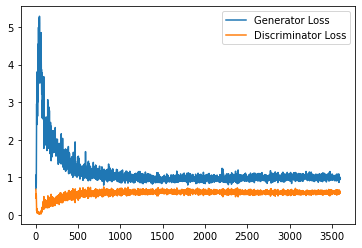

Step 72500: Generator loss: 0.9742784835100174, discriminator loss: 0.6018685650229454


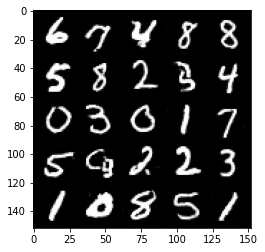

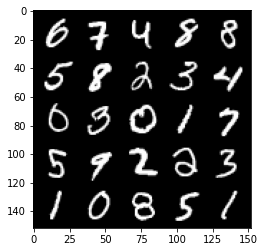

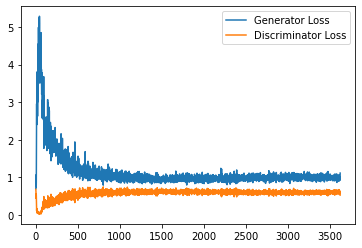

Step 73000: Generator loss: 0.9720290060043335, discriminator loss: 0.6059101108312607


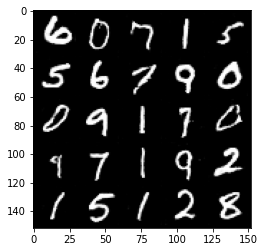

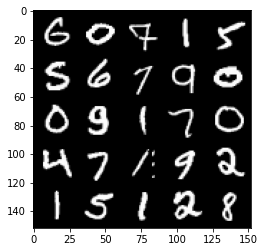

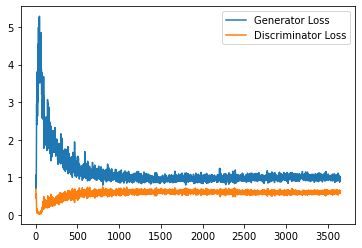

Step 73500: Generator loss: 0.9687794538736343, discriminator loss: 0.6087021077275276


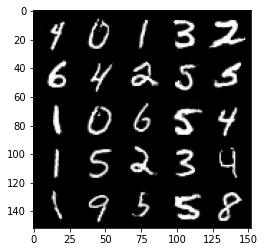

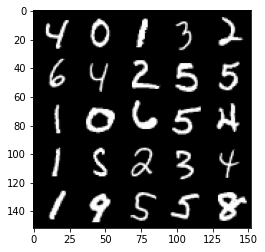

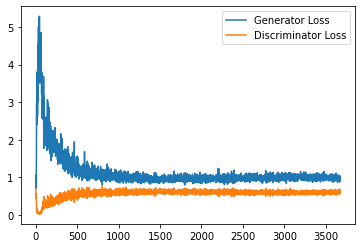

Step 74000: Generator loss: 0.9861356817483902, discriminator loss: 0.6110570406913758


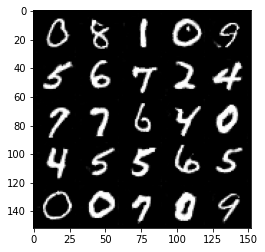

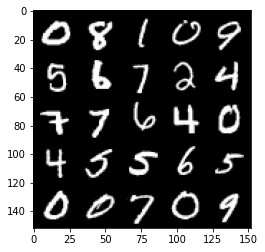

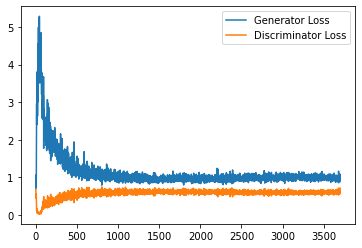

Step 74500: Generator loss: 0.9732910521030426, discriminator loss: 0.6029622554183006


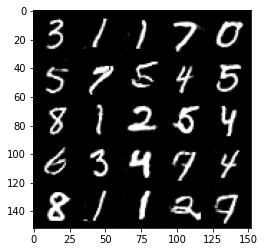

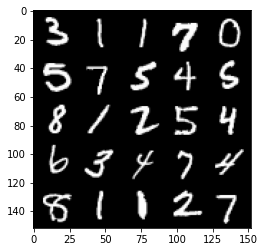

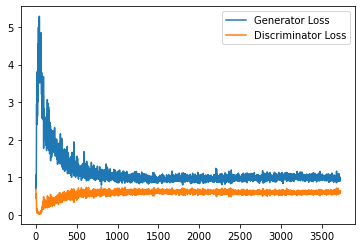

Step 75000: Generator loss: 0.9620028120279313, discriminator loss: 0.6038468851447105


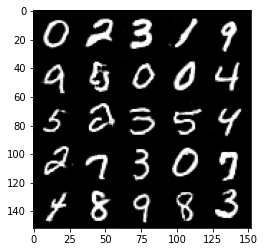

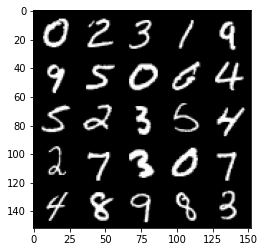

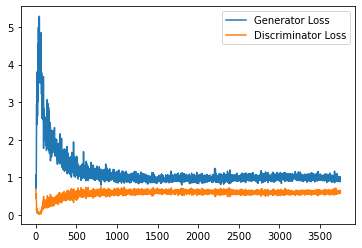

Step 75500: Generator loss: 0.977199410200119, discriminator loss: 0.6109044635295868


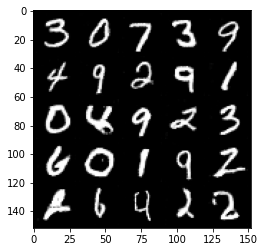

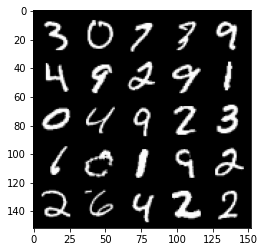

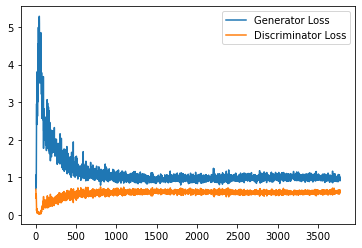

Step 76000: Generator loss: 0.9702492209672928, discriminator loss: 0.6093736883401871


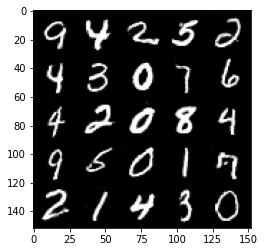

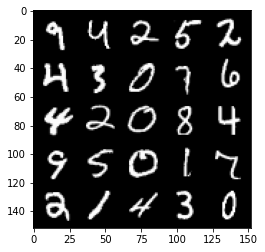

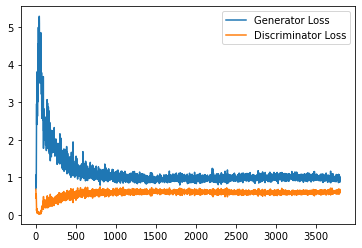

Step 76500: Generator loss: 0.9679531314373017, discriminator loss: 0.6129526798725128


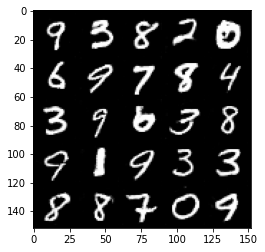

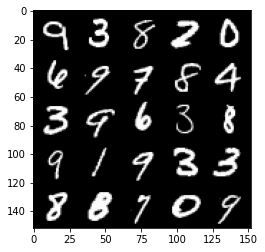

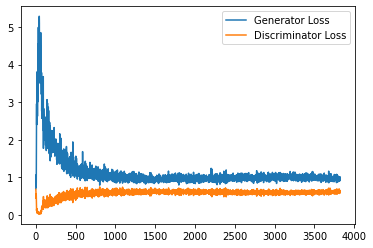

Step 77000: Generator loss: 0.9838534986972809, discriminator loss: 0.6097591606974602


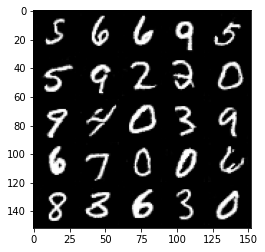

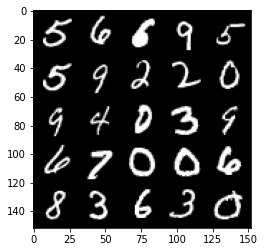

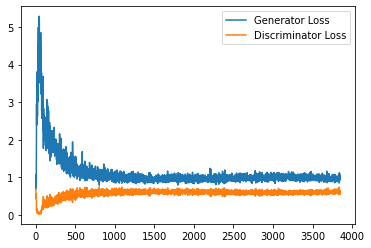

Step 77500: Generator loss: 0.9564987511634827, discriminator loss: 0.6111633136868477


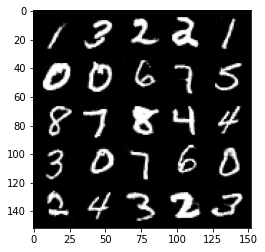

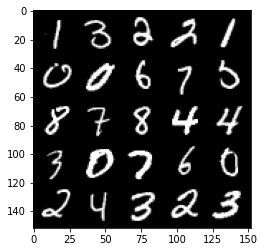

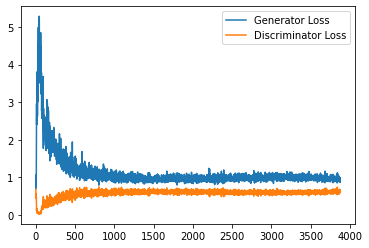

Step 78000: Generator loss: 0.9594454613924026, discriminator loss: 0.6143329091072083


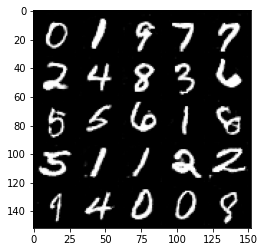

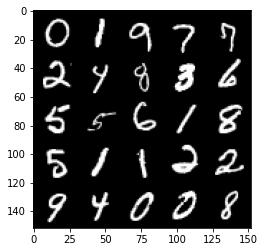

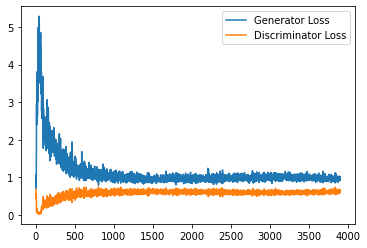

Step 78500: Generator loss: 0.9642164167165757, discriminator loss: 0.6157284389138222


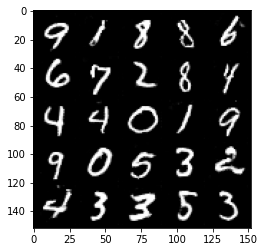

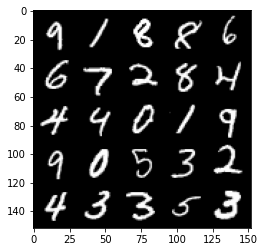

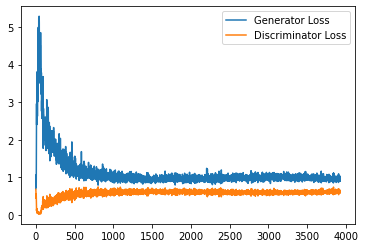

Step 79000: Generator loss: 0.9717767869234085, discriminator loss: 0.613604766190052


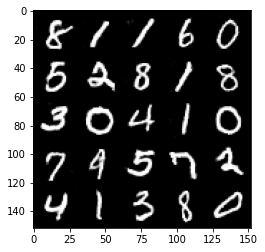

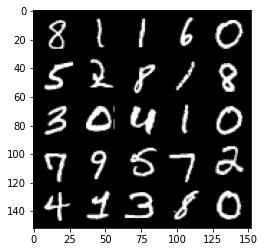

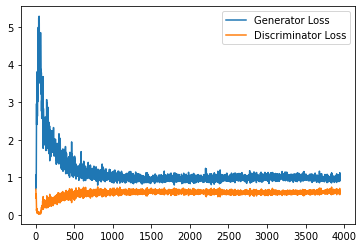

Step 79500: Generator loss: 0.9573882176876068, discriminator loss: 0.6142711748480797


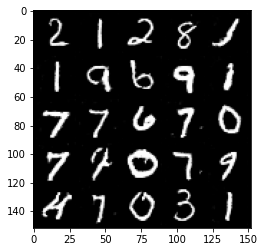

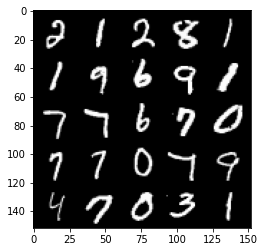

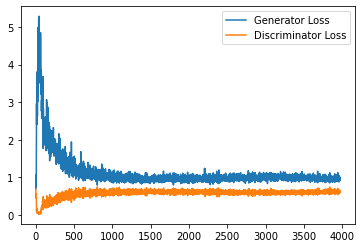

Step 80000: Generator loss: 0.9568283944129944, discriminator loss: 0.6177798383235932


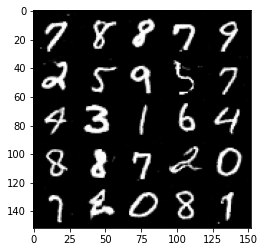

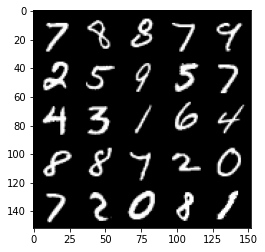

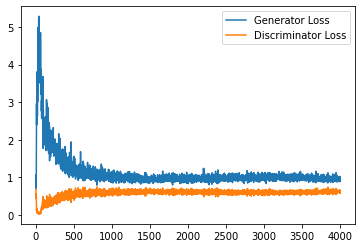

Step 80500: Generator loss: 0.9560737972259521, discriminator loss: 0.6188317890763283


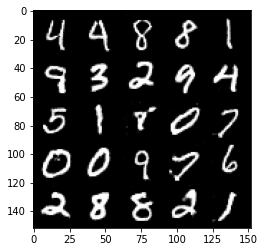

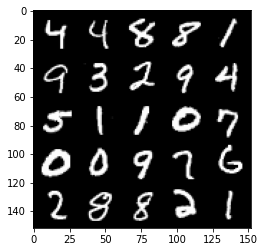

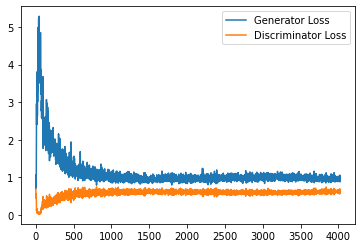

Step 81000: Generator loss: 0.9704508987665177, discriminator loss: 0.615803568482399


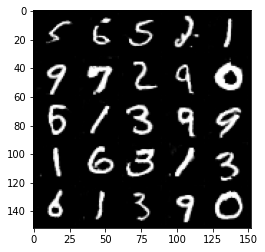

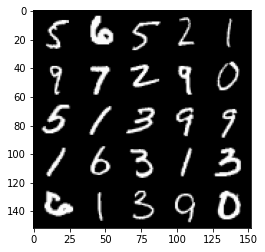

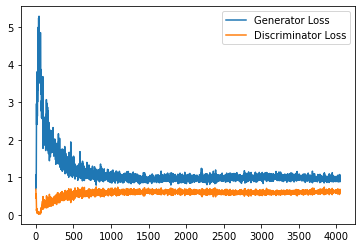

Step 81500: Generator loss: 0.9510356781482696, discriminator loss: 0.6243702192306518


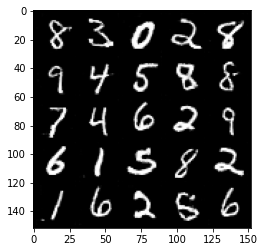

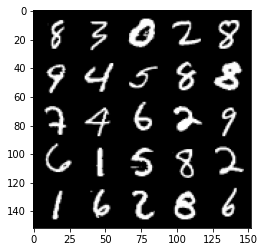

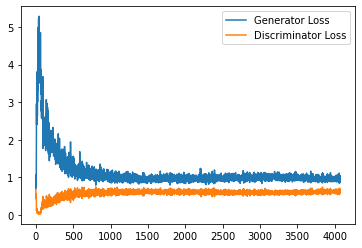

Step 82000: Generator loss: 0.9531826922893524, discriminator loss: 0.6199907504320145


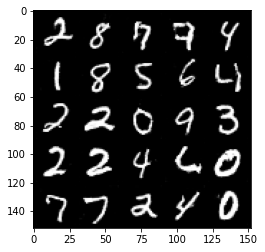

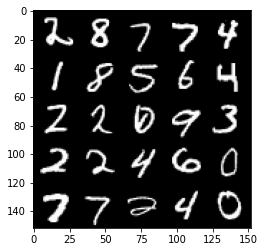

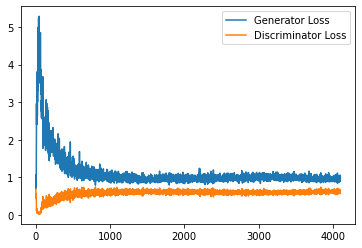

Step 82500: Generator loss: 0.9303265585899353, discriminator loss: 0.6221787374019623


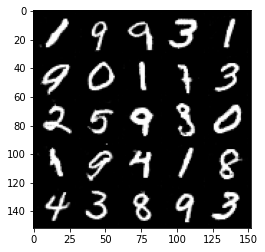

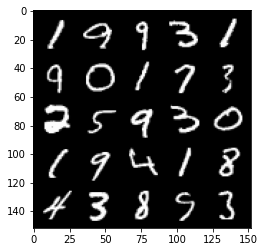

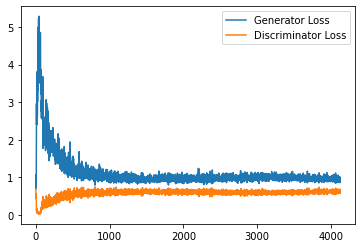

Step 83000: Generator loss: 0.944411400437355, discriminator loss: 0.6181194789409638


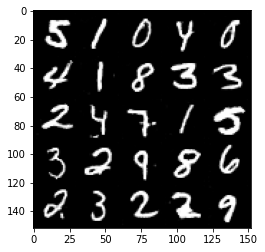

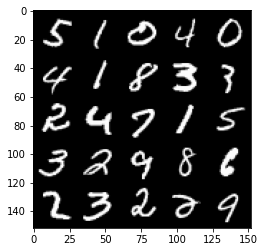

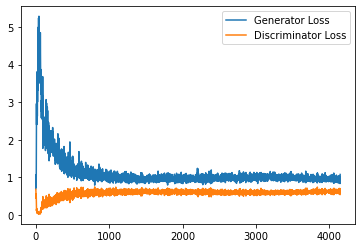

Step 83500: Generator loss: 0.9512685669660568, discriminator loss: 0.6240167841911316


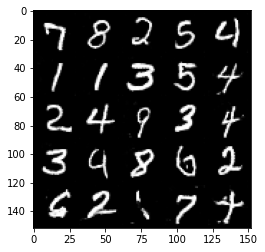

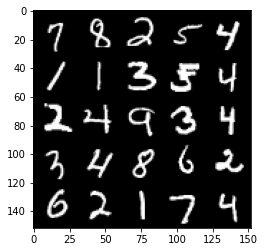

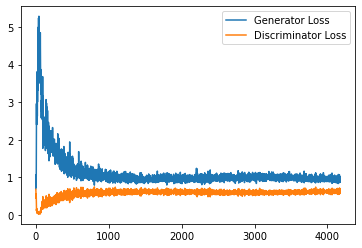

Step 84000: Generator loss: 0.965189207315445, discriminator loss: 0.623779620051384


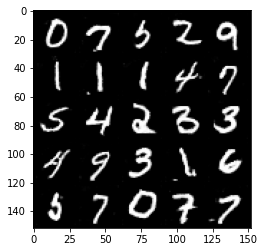

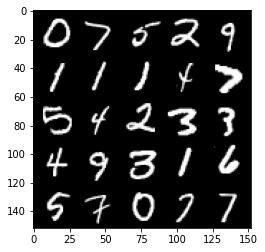

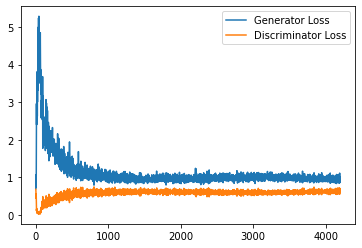

Step 84500: Generator loss: 0.9375400451421738, discriminator loss: 0.6264400944709778


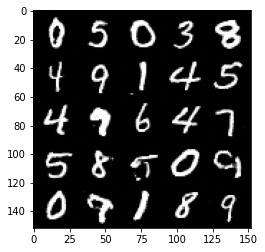

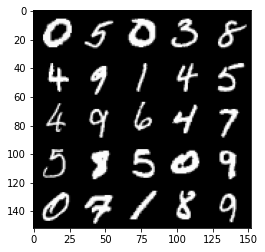

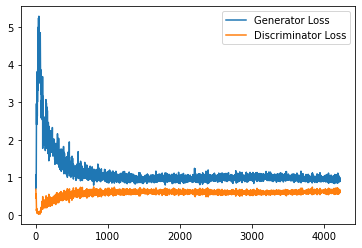

Step 85000: Generator loss: 0.9259345436096191, discriminator loss: 0.6250239168405533


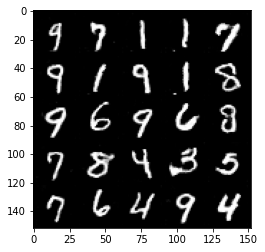

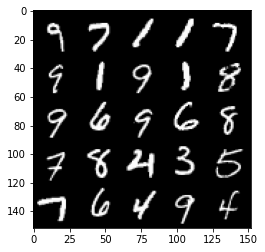

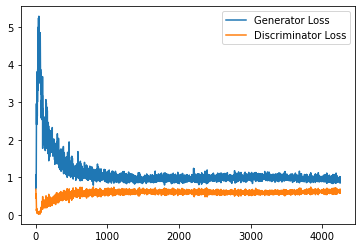

Step 85500: Generator loss: 0.940666791677475, discriminator loss: 0.6246250604391098


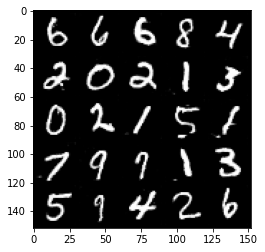

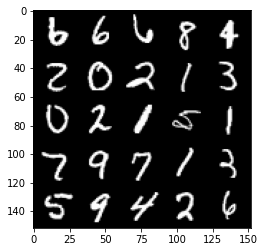

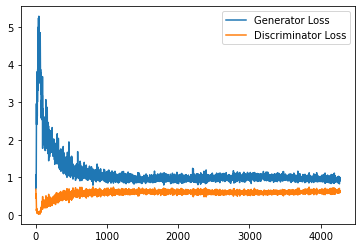

Step 86000: Generator loss: 0.9321525446176528, discriminator loss: 0.6257013736963272


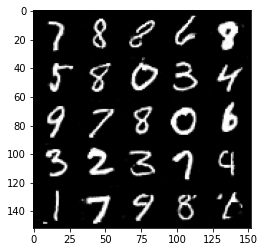

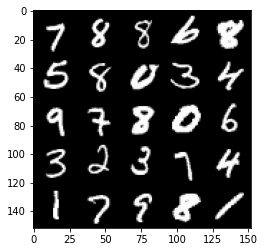

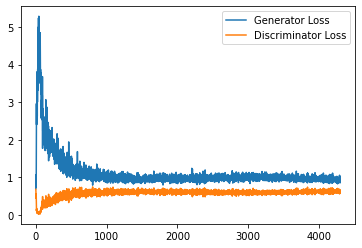

Step 86500: Generator loss: 0.9226366431713104, discriminator loss: 0.6323655707836151


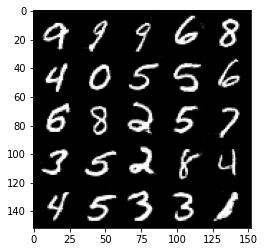

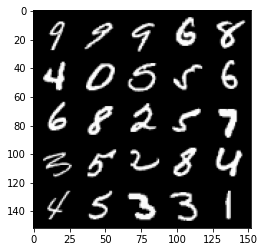

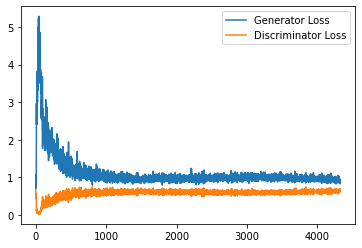

Step 87000: Generator loss: 0.9361544781923294, discriminator loss: 0.6261440417170525


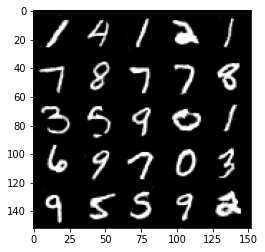

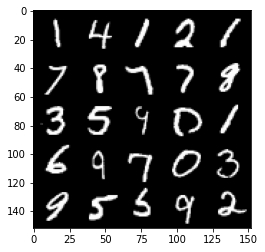

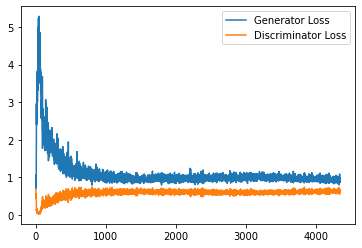

Step 87500: Generator loss: 0.9133570014238358, discriminator loss: 0.6302085754871368


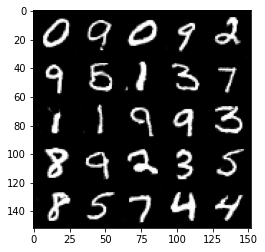

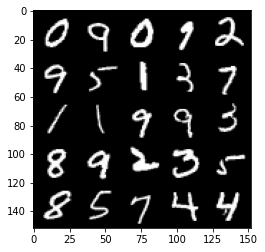

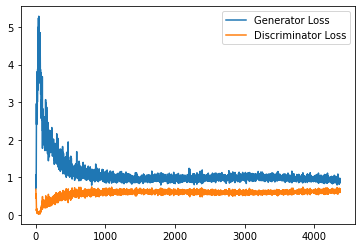

Step 88000: Generator loss: 0.9315201770067215, discriminator loss: 0.6268019014596939


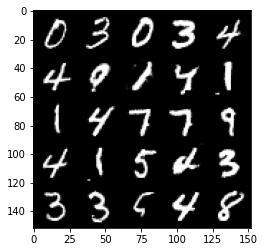

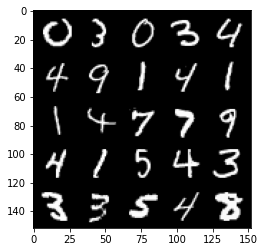

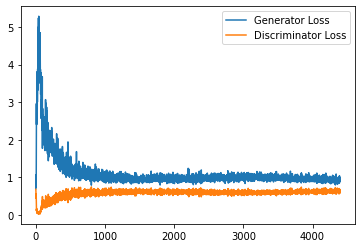

Step 88500: Generator loss: 0.9175090596675873, discriminator loss: 0.6312662696242333


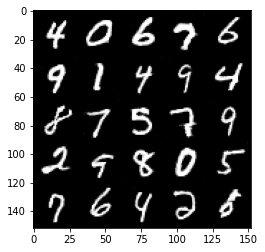

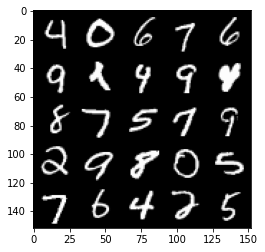

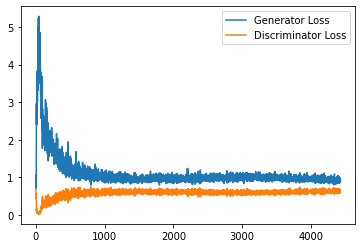

Step 89000: Generator loss: 0.9113700208663941, discriminator loss: 0.6273919472694397


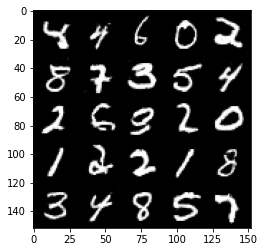

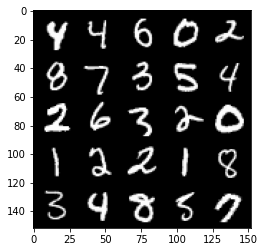

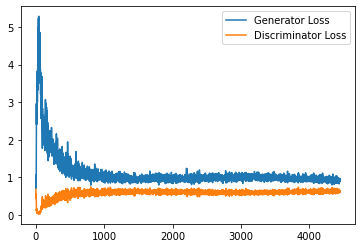

Step 89500: Generator loss: 0.9326022039651871, discriminator loss: 0.6306921924352646


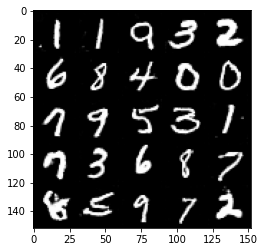

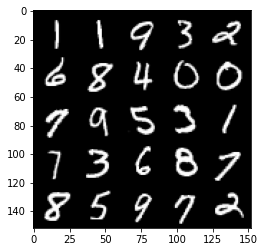

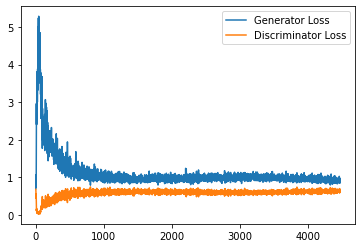

Step 90000: Generator loss: 0.9298651369810105, discriminator loss: 0.63127741086483


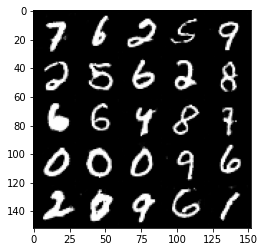

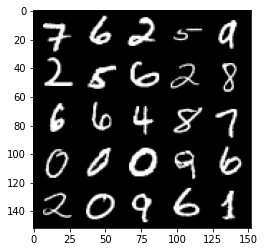

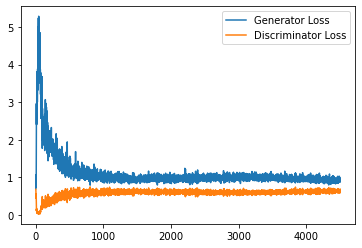

Step 90500: Generator loss: 0.9283094000816345, discriminator loss: 0.634950561106205


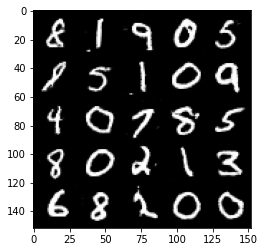

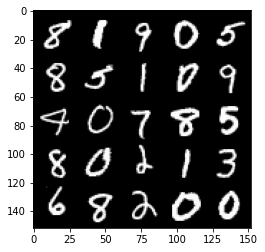

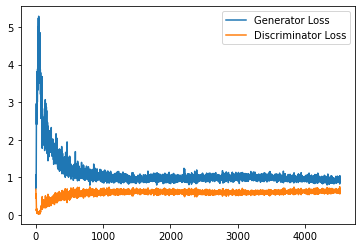

Step 91000: Generator loss: 0.9465599223375321, discriminator loss: 0.6259828256368637


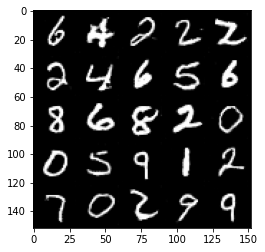

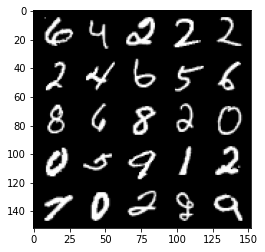

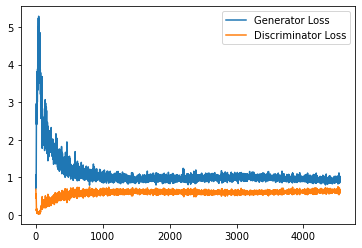

Step 91500: Generator loss: 0.9217678924798965, discriminator loss: 0.6307561329603195


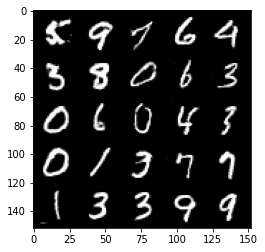

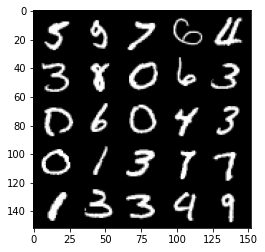

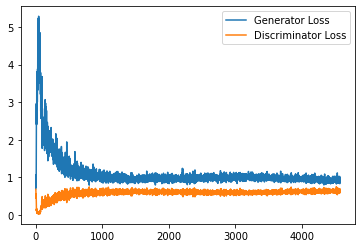

Step 92000: Generator loss: 0.908579042673111, discriminator loss: 0.6294842891693115


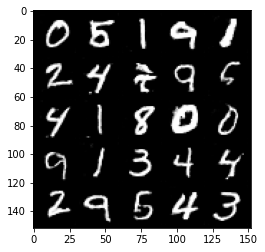

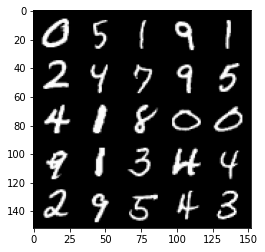

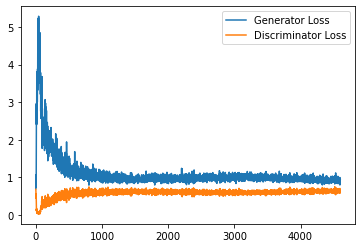

Step 92500: Generator loss: 0.9234472818374634, discriminator loss: 0.6364221103787422


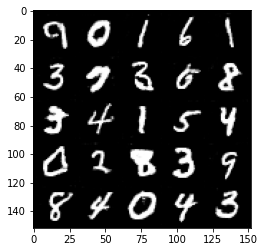

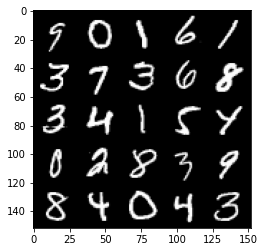

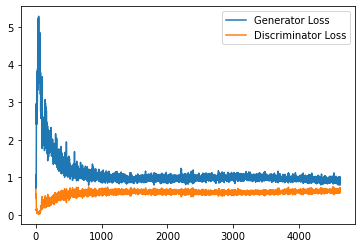

Step 93000: Generator loss: 0.9218043266534806, discriminator loss: 0.6320378848314285


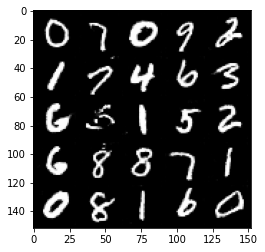

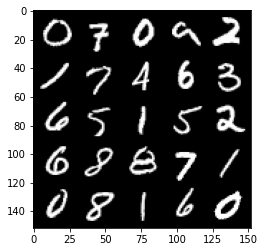

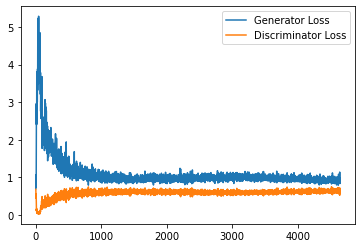

Step 93500: Generator loss: 0.9233607696294784, discriminator loss: 0.6289664821624756


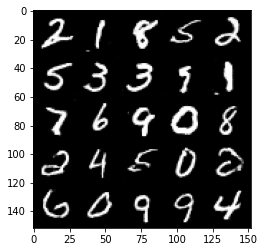

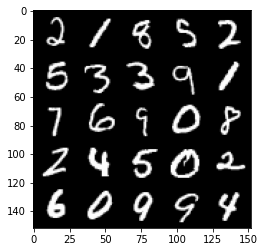

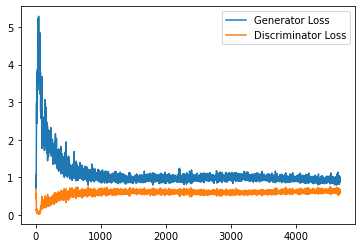

In [18]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels.detach())
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [19]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

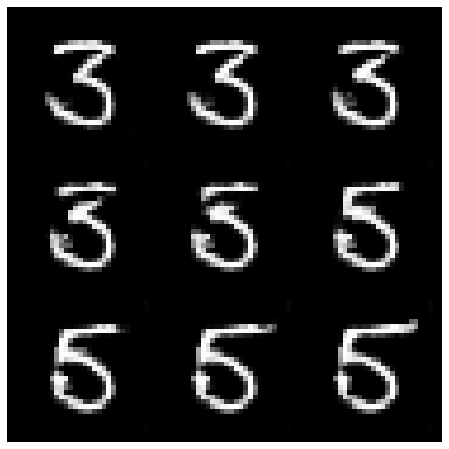

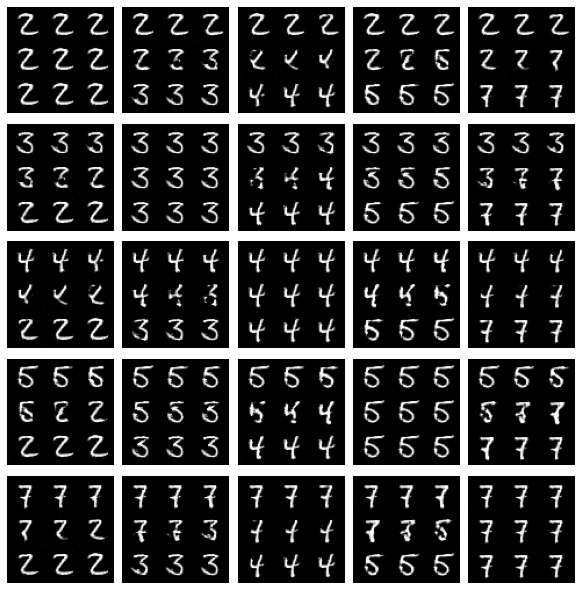

In [23]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 3 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

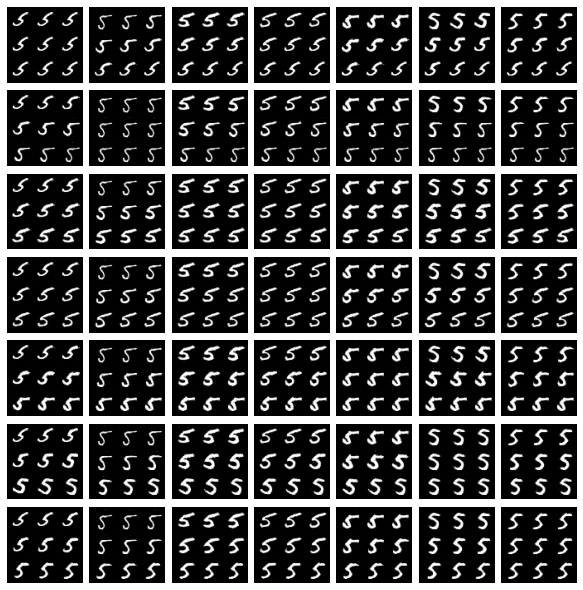

In [27]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 7 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()